# object detection

Object detection in computer vision refers to the task of identifying and locating objects of interest within an image or video frame. It is a fundamental task in computer vision with numerous applications, including autonomous vehicles, surveillance, robotics, and image retrieval.

Object detection is pre-trained

Object detection search in the objects inside an image but image classification classify the image totally

## Key Components of Object Detection:
    1. Localization: 
        Determining the spatial location (usually in terms of bounding boxes) of objects within an image.

    2. Classification: 
        Assigning a label or class to each detected object to indicate what type of object it is (e.g., person, car, dog).


## Approaches to Object Detection:
    1. Traditional Computer Vision Methods:
        Sliding Window: The image is scanned with a window of varying sizes and aspect ratios to detect objects at different scales.

        Region-based Methods (e.g., R-CNN, Fast R-CNN, Faster R-CNN): These methods propose regions likely to contain objects and then classify these regions.

    2. Modern Deep Learning-based Methods:
        Single Shot Detectors (SSD): These networks use a single deep neural network to predict bounding boxes and class probabilities directly from feature maps in a single evaluation.

        You Only Look Once (YOLO): YOLO divides the image into a grid and predicts bounding boxes and probabilities for each grid cell.

        EfficientDet: A recent advancement that aims to improve both efficiency and accuracy of object detection models.

        Mask R-CNN: Extends Faster R-CNN by adding a branch for predicting segmentation masks on each Region of Interest (RoI).



## Applications:
    1. Autonomous Vehicles: 
Detecting pedestrians, vehicles, and traffic signs.

    2. Surveillance: 
Monitoring activities and identifying intruders.

    3. Medical Imaging: 
Identifying tumors and anatomical structures.

    4. Retail: 
Tracking inventory and analyzing customer behavior.

    4. Augmented Reality: 
Overlaying virtual objects onto real-world scenes.

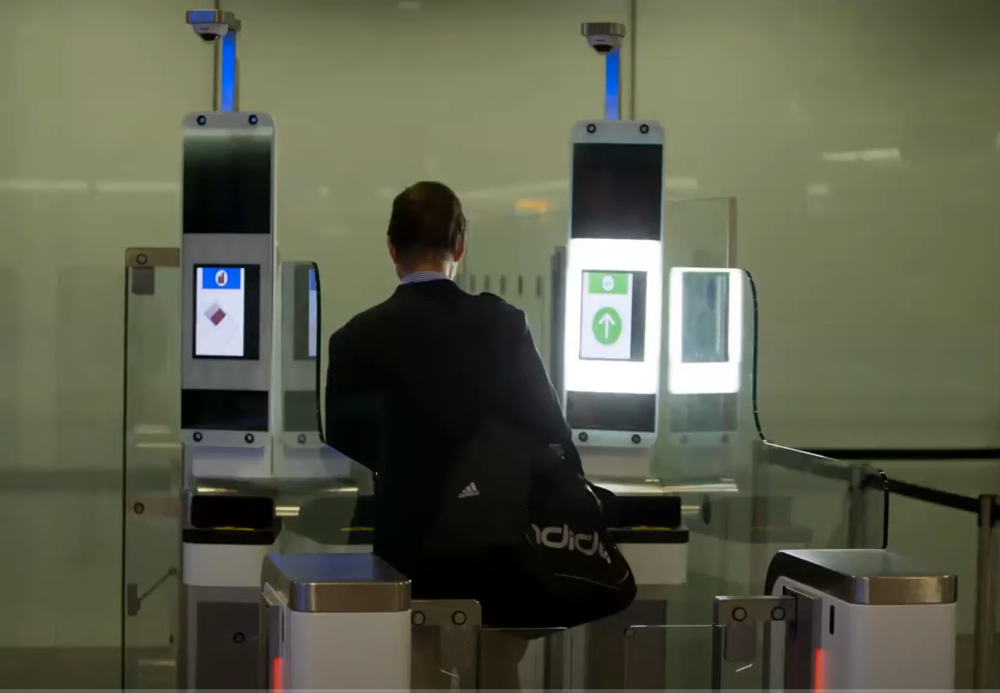


## image classification VS object detection
Image Classification and Object Detection are two fundamental tasks in the field of computer vision, but they serve different purposes and are used in different scenarios:

### Image Classification:
    Definition: 
        Image classification involves assigning a single label or category to an entire image based on its content. The task is to determine what is present in the image as a whole.

    Output: 
        The output of image classification is a single label that represents the dominant object or scene category in the ima   ge.

    Examples:
        Classifying whether an image contains a cat or a dog.
        Identifying whether an image     is of a car, a plane, or a bicycle.

    Applications:
        Content-based image retrieval.
        Basic image understanding tasks.
        Categorizing images in social media.
    
    Methods:
        Typically uses convolutional neural networks (CNNs) or other deep learning architectures.
        Training involves feeding labeled images into the network, which learns to associate specific features with each class label.

### Object Detection:
    Definition: 
        Object detection involves identifying and locating multiple objects within an image and assigning each object a class label and a bounding box indicating its position.

    Output: 
        For each object detected, the output includes:
        Class label (e.g., person, car, bicycle).
        Bounding box coordinates (x, y, width, height) specifying where the object is located in the image.
    
    Examples:
        Detecting and locating pedestrians, cars, and traffic lights in an image of a street scene.
        Finding and identifying multiple types of fruits in an image of a fruit bowl.
    
    Applications:
        Autonomous driving for detecting vehicles, pedestrians, and obstacles.
        Surveillance systems for identifying people and objects of interest.
        Robotics for interacting with objects in an environment.

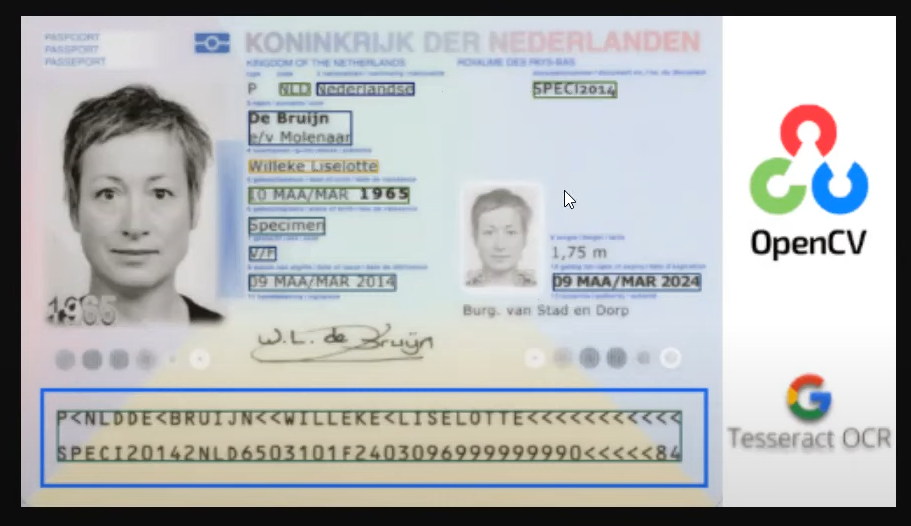  

    Methods:
        Utilizes advanced techniques like region-based convolutional neural networks (R-CNN), You Only Look Once (YOLO), or Single Shot Multibox Detector (SSD).
        Combines object localization and classification within a single integrated framework.



## Object Detection Workflow:
    Input Image: 
        An image or video frame containing objects to be detected.

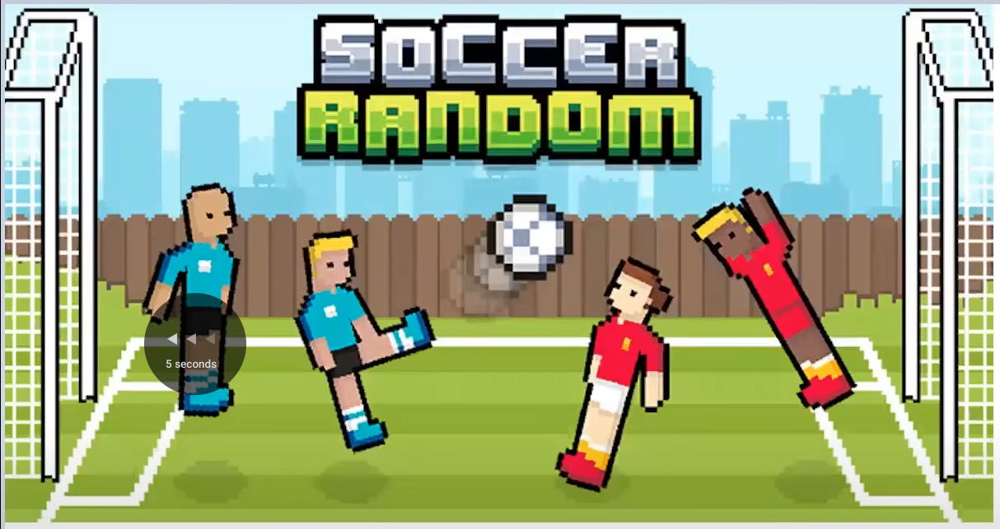

    Feature Extraction: 
        Use of convolutional neural networks (CNNs) to extract features from the input image.

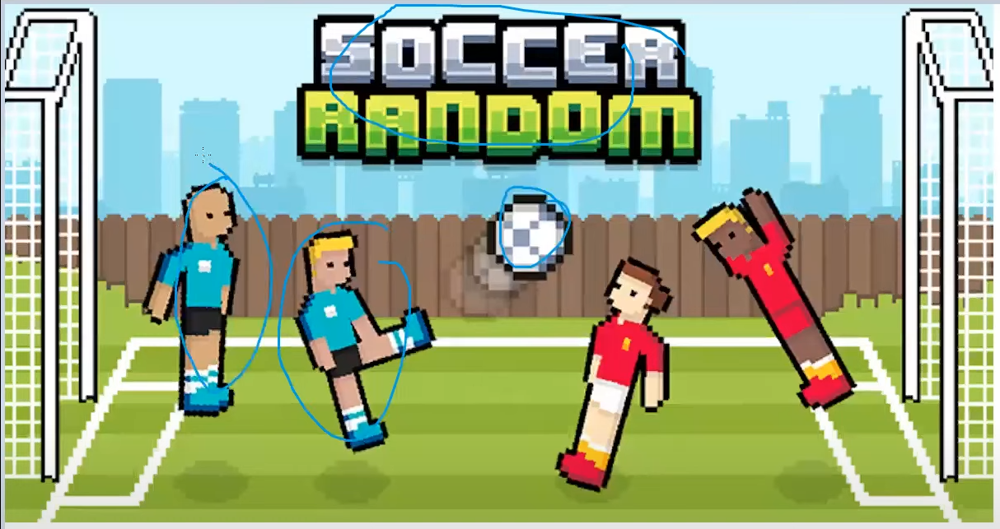

    Object Proposals (Optional): 
        Generation of region proposals to localize potential objects (in some methods like R-CNN variants).

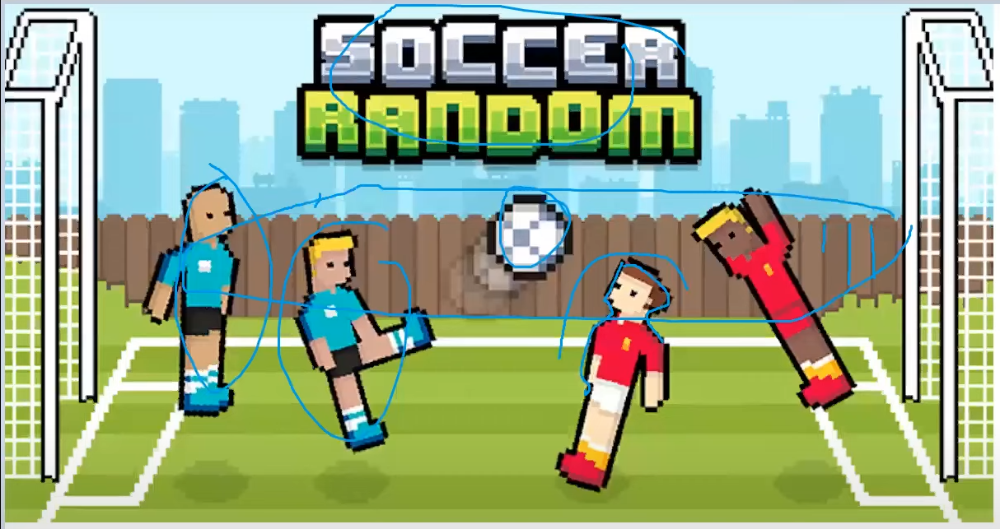

    Bounding Box Regression: 
        Adjusting the bounding boxes to tightly fit around detected objects.

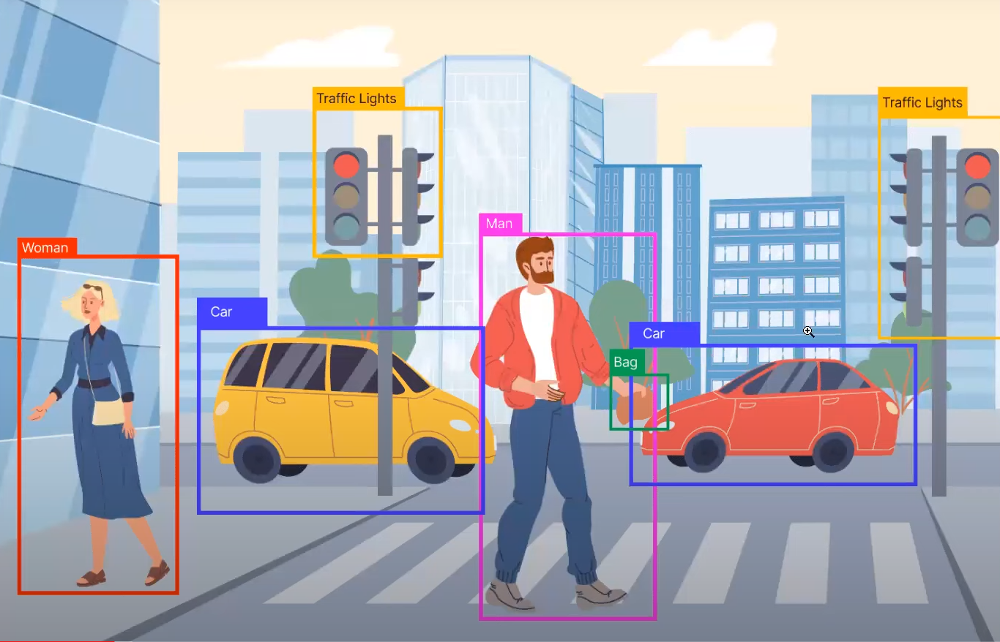

    Object Classification: 
        Assigning class labels to the detected objects.

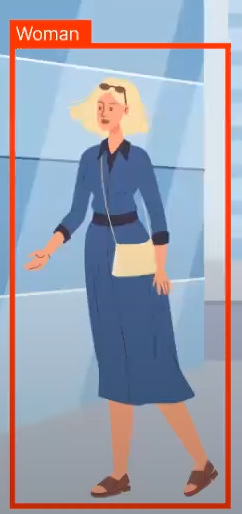

        Scanning by CNN, Recognition by Library

    Post-processing: 
        - Filtering out duplicate detections, applying non-maximum suppression to remove overlapping bounding boxes, and refining final detections.
        - it is considered the context of the image to distigusih between 2 objects which is similar to each other like ball and moon
        - can use Cos similartiy to detect if the object similar to other so this means that the two things are the samme 
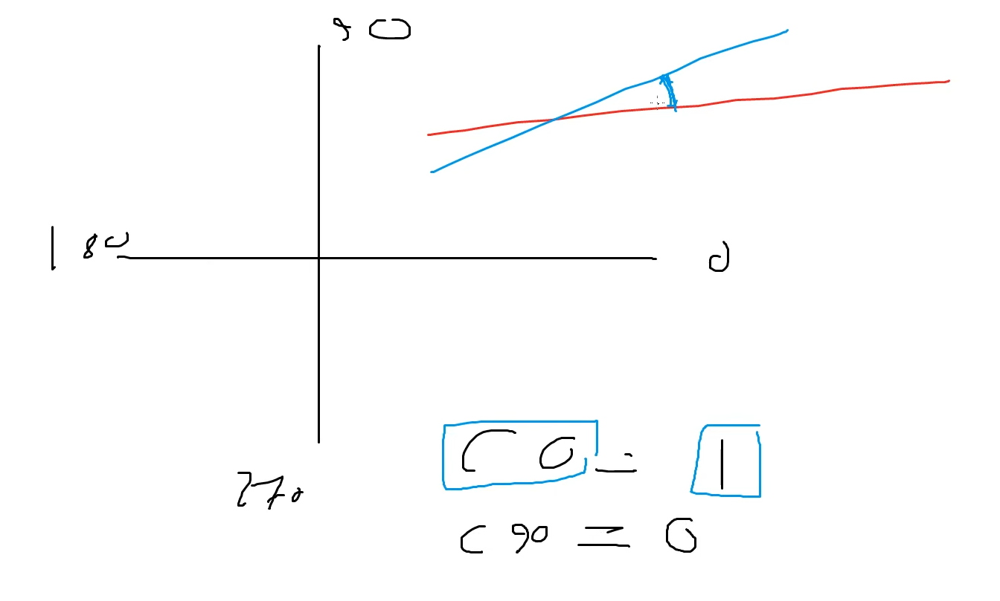
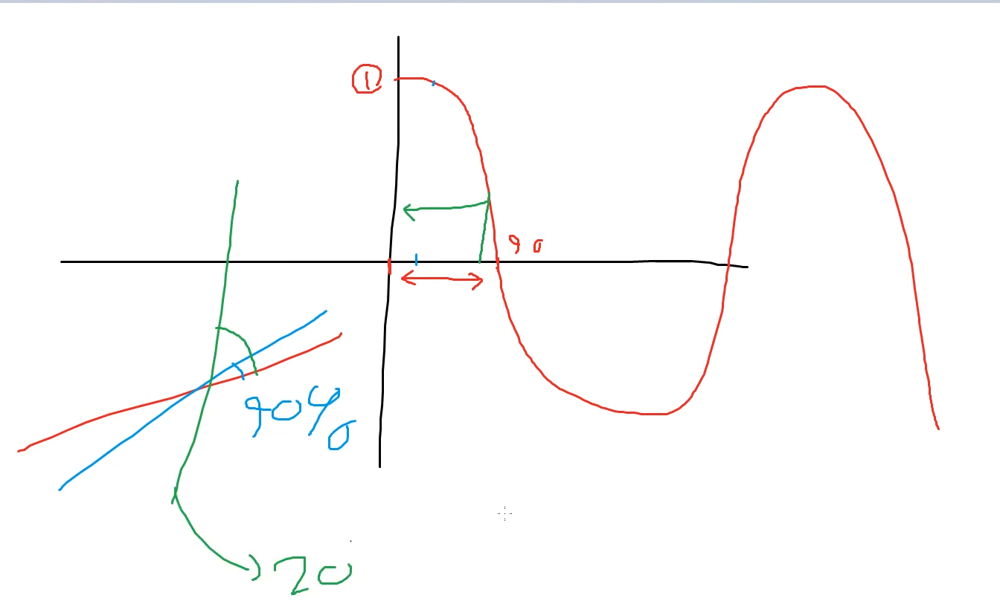
        imagine we need detect somthing which the model have 2 choices so the solution in cos similratiy between the required and the 1 choice and the other
        according the result will determine whhether the required is the first or the second 




## challenges
    1. Human ceiling accuracy
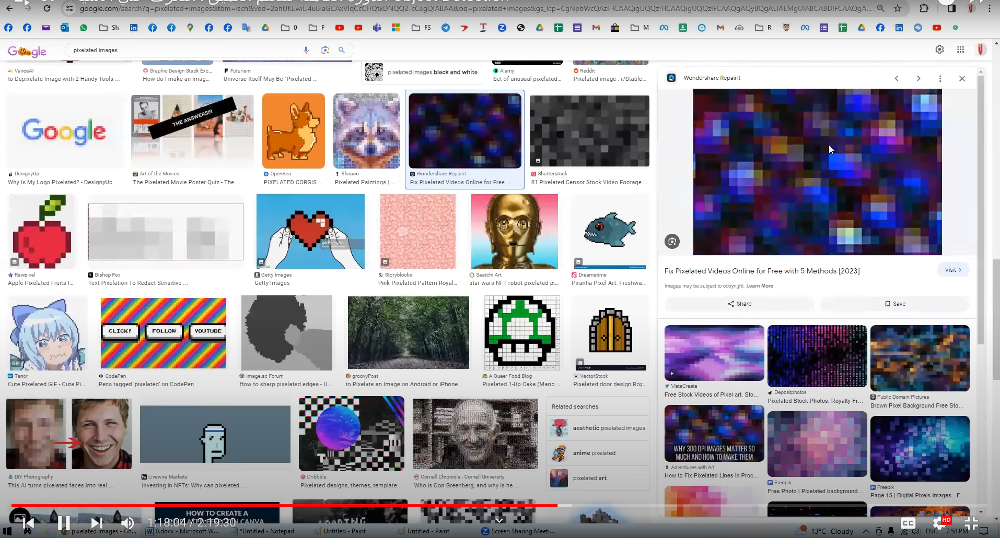    

    2. Blocking
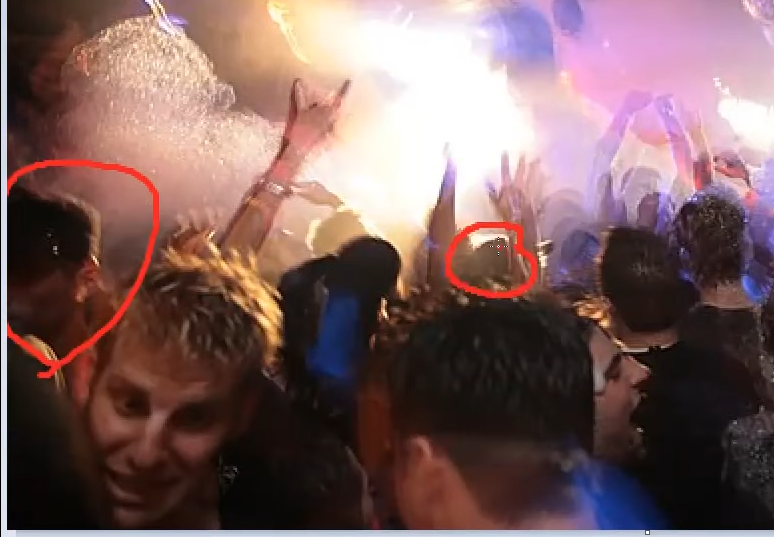
        
so we have to train the model with the same of these issues 


## Yolo
YOLO (You Only Look Once) is a popular real-time object detection algorithm. It's known for its speed and ability to detect objects in images and videos swiftly. 
YOLO's approach differs from other object detection methods like R-CNN and its variants (Fast R-CNN, Faster R-CNN) which use a region proposal network (RPN) for generating region proposals followed by classification. This makes YOLO particularly suited for applications where real-time processing is essential.
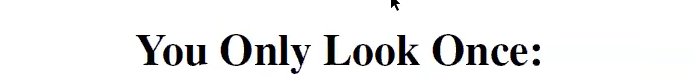
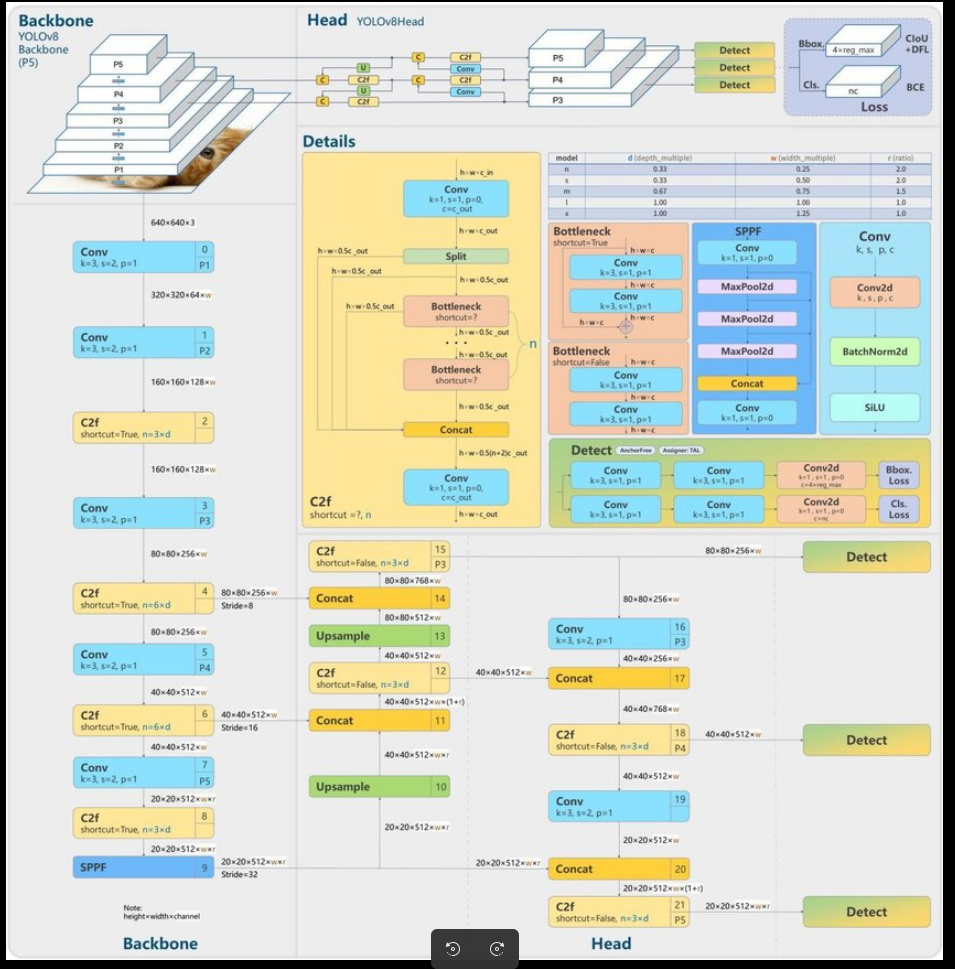
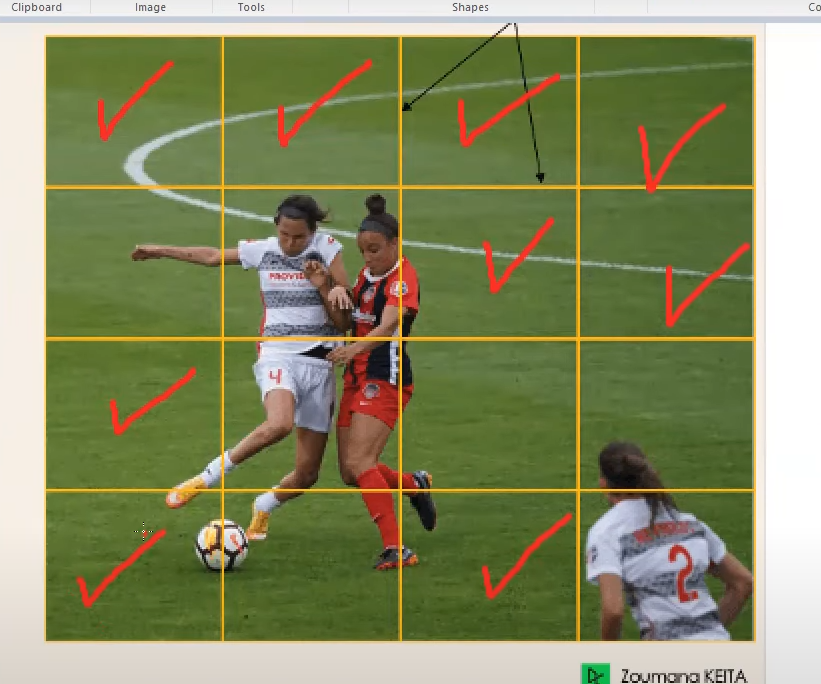
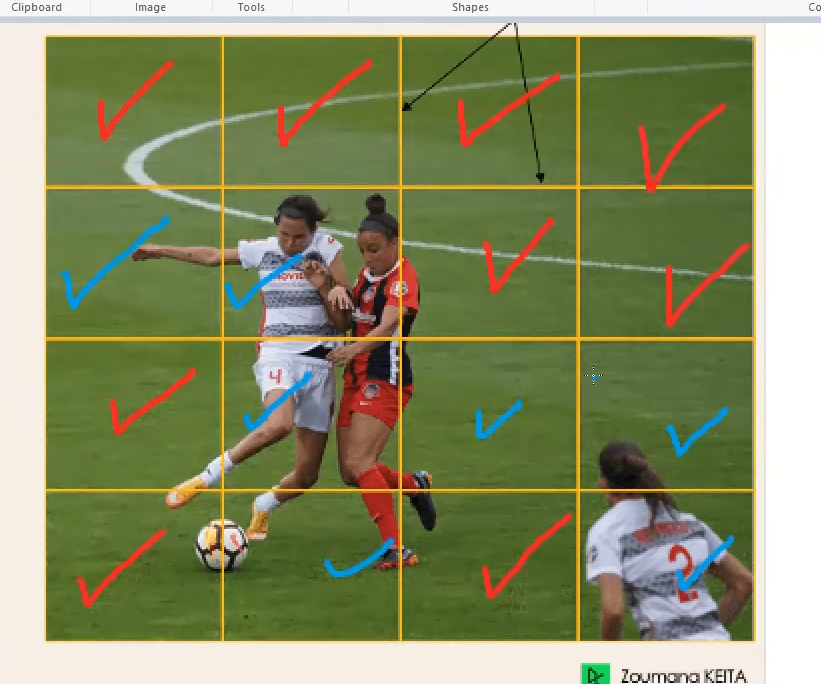
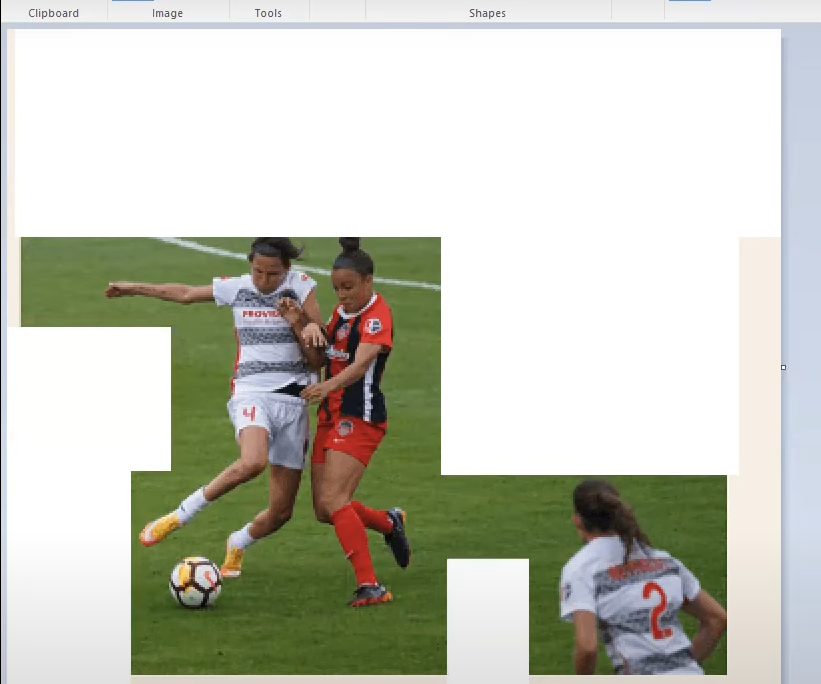
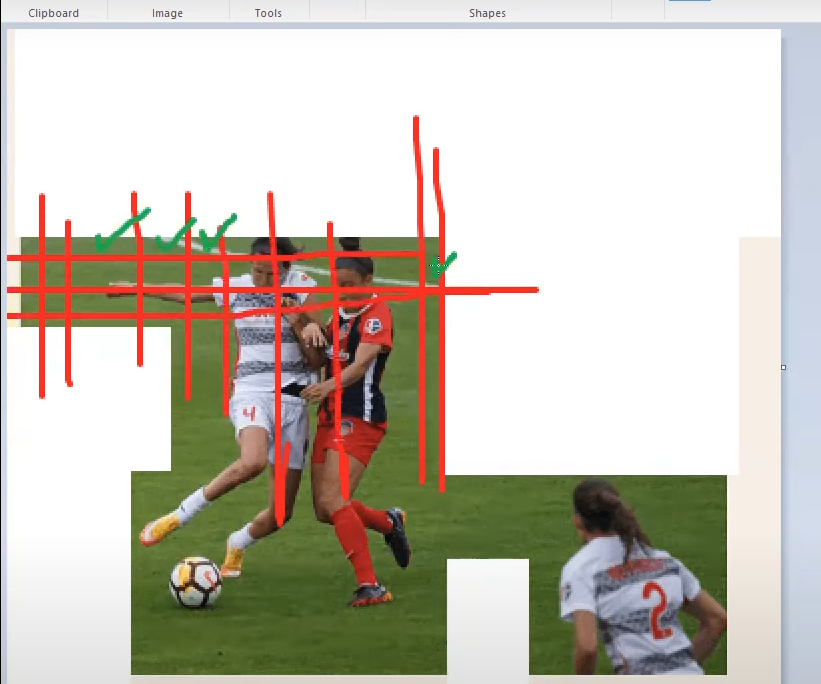
this cutting according to the edges technique
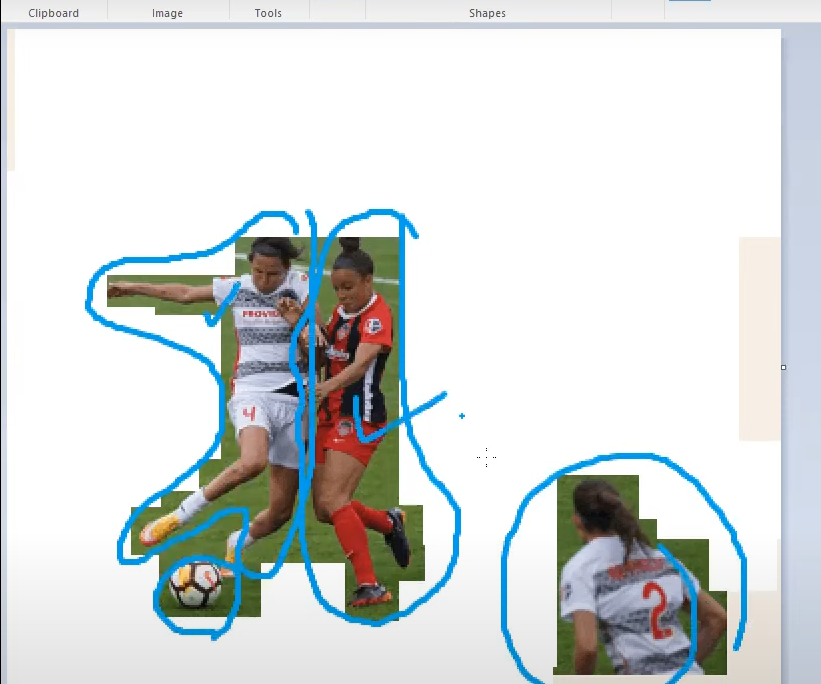
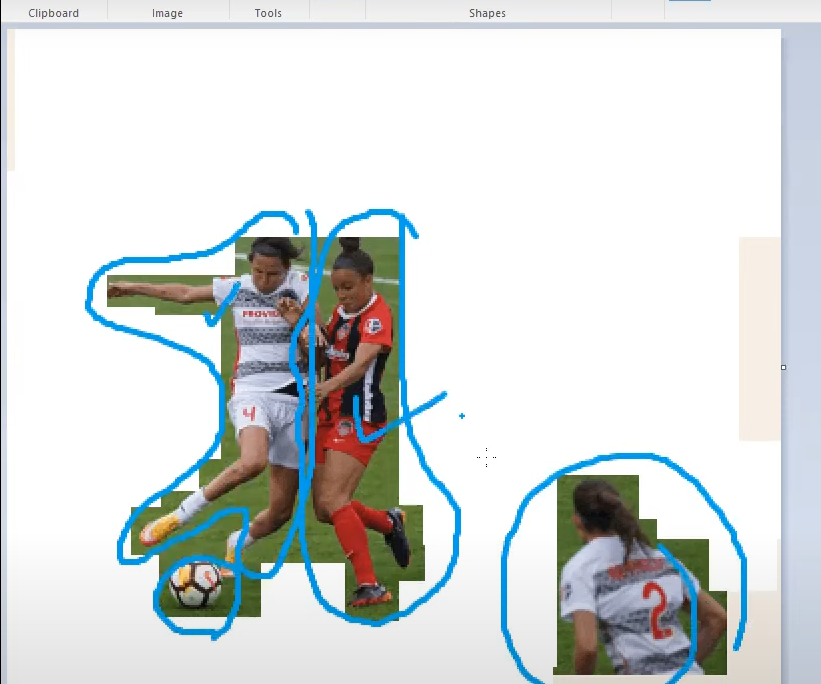
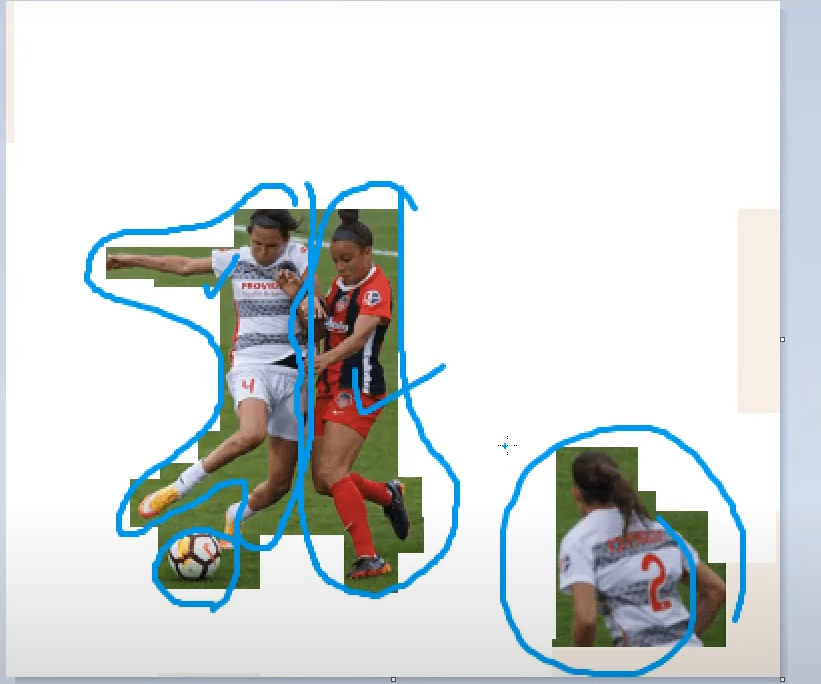
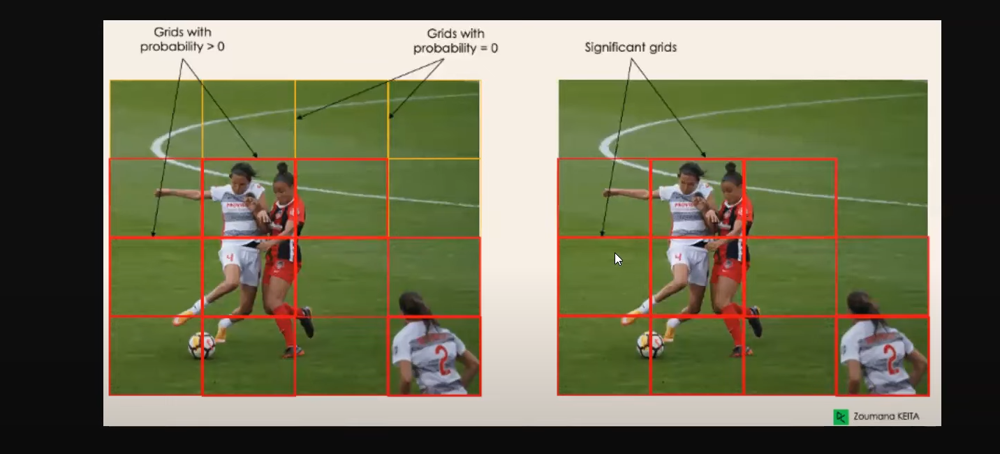
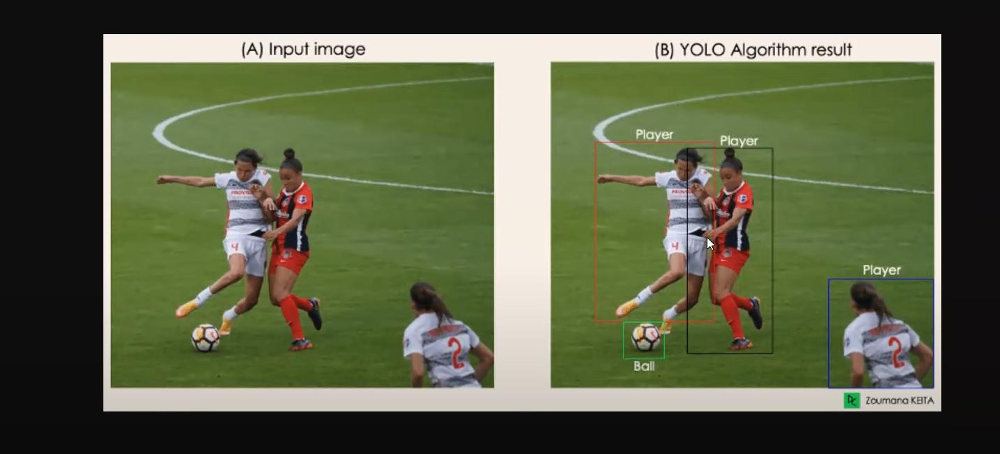
...
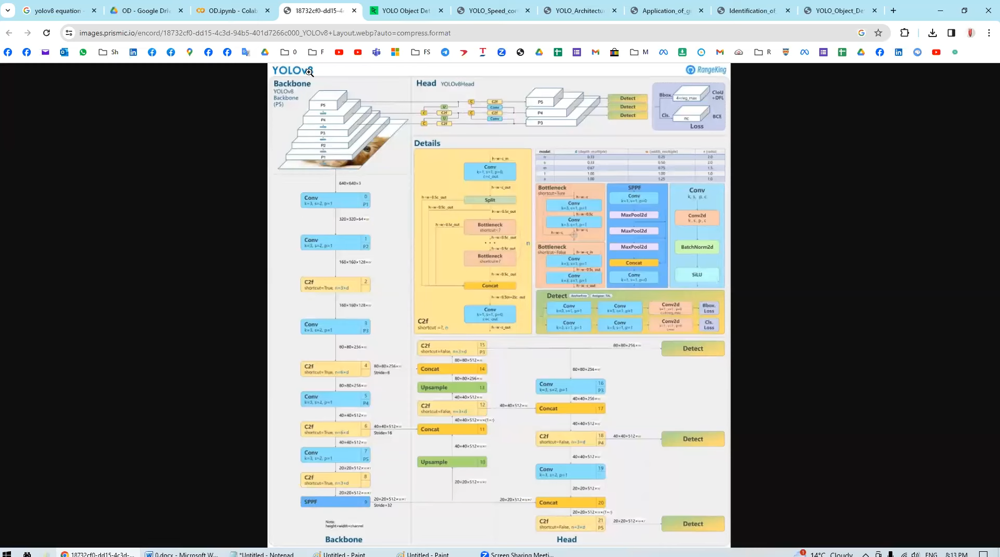
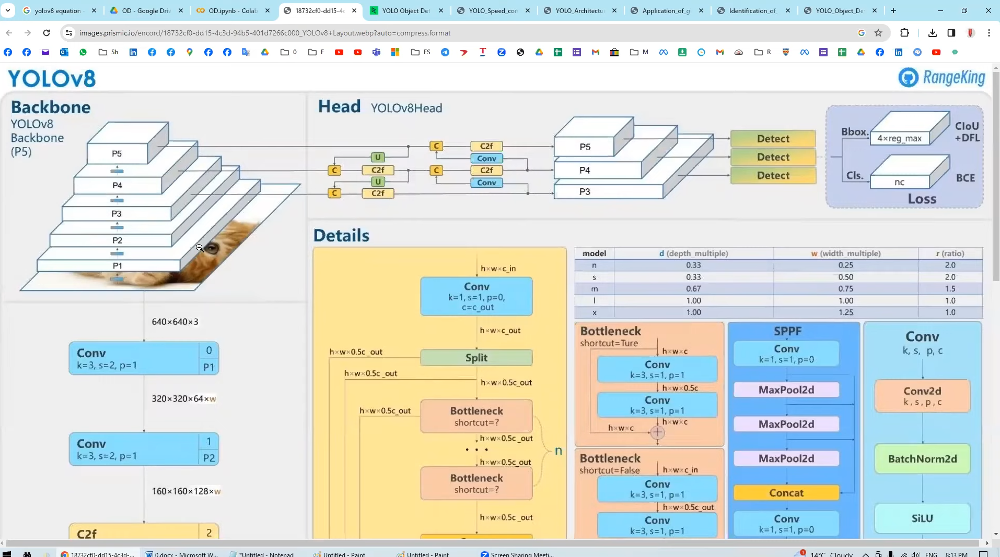
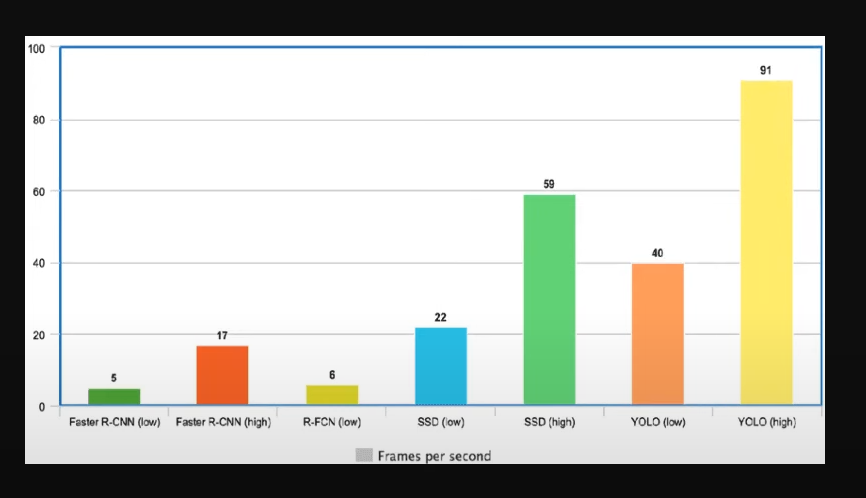
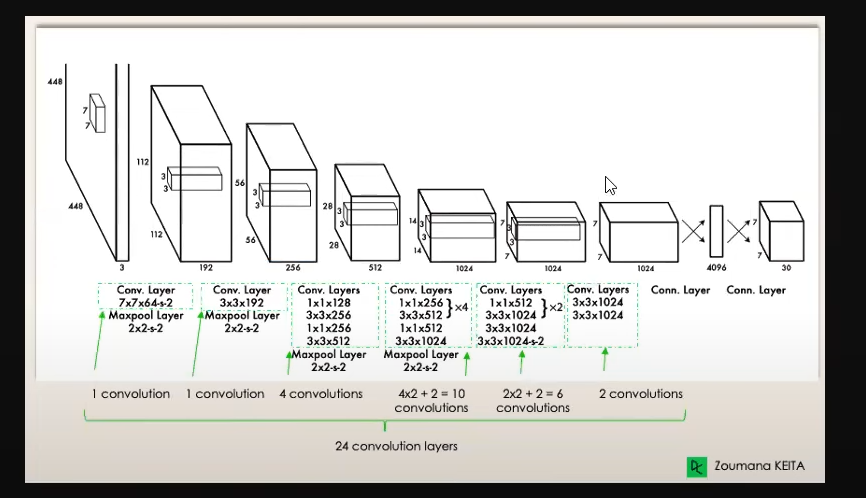
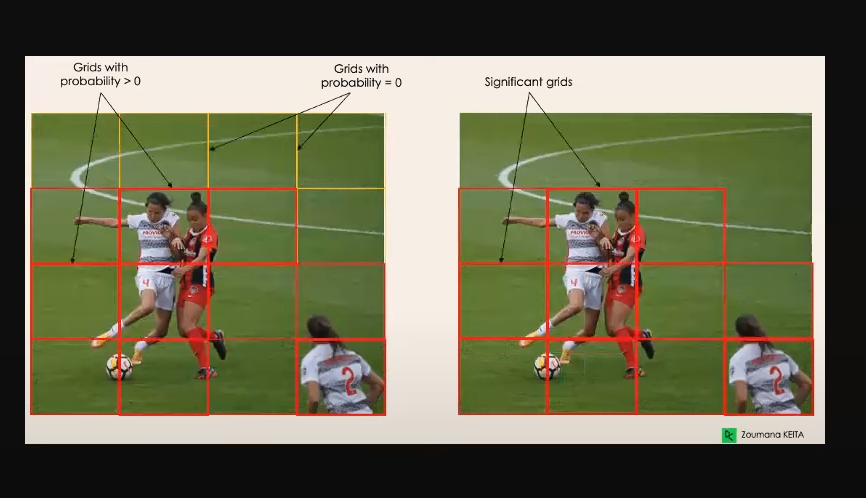


Yolo Can not detect accurately the numbers while OCR can detect it
Yolo not lib it is a method while OCR is a lib

Code :

https://www.kaggle.com/code/safurahajiheidari/yolov8-object-detection-on-self-driving-car-data

In [45]:
import numpy as np
import PIL
import os
from PIL import Image
from IPython.display import display
import matplotlib.pyplot as plt
from glob import glob
import random
import cv2
import warnings
warnings.simplefilter('ignore')

In [46]:
import importlib

# Name of the package to check
package_name = 'ultralytics'

# Try importing the package
try:
    importlib.import_module(package_name)
    print(f'{package_name} is already installed.')
except ImportError:
    # Package not found, so install it
    print(f'Installing {package_name}...')
    !pip install {package_name}


ultralytics is already installed.


In [47]:
import ultralytics
from ultralytics import YOLO
yolo_model = YOLO('yolov8m.pt')

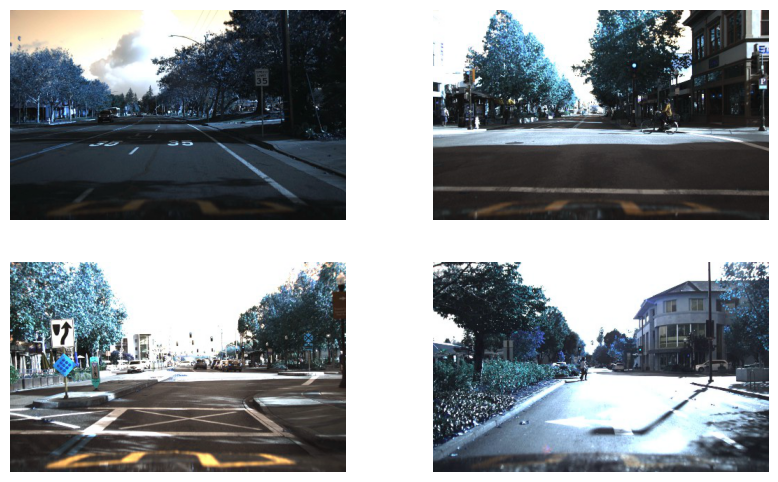

In [48]:

root_path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/images/*'
num_samples = 4
images_data = glob(root_path)
random_image = random.sample(images_data, num_samples)

plt.figure(figsize=(10,6))
for i in range(num_samples):
    plt.subplot(2,2,i+1)
    plt.imshow(cv2.imread(random_image[i]))
    plt.axis('off')


In [49]:
# Create a list to store the images

#https://github.com/pytorch/vision?tab=readme-ov-file#installation

import sys
import torch
import torchvision


print(sys.executable)


print(sys.version)
print("PyTorch version:", torch.__version__)
print("torchvision version:", torchvision.__version__)


images = []
for i in range(num_samples):
    yolo_outputs = yolo_model.predict(random_image[i])
    output = yolo_outputs[0]
    box = output.boxes
    names = output.names

    for j in range(len(box)):
        labels = names[box.cls[j].item()]
        coordinates = box.xyxy[j].tolist()
        confidence = np.round(box.conf[j].item(), 2)
        #print(f'In this image {len(box)} objects has been detected.')
        print(f'Object {j + 1} is: {labels}')
        print(f'Coordinates are: {coordinates}')
        print(f'Confidence is: {confidence}')
        print('-------')

    # Store the image in the 'images' list
    images.append(output.plot()[:, :, ::-1])


/home/ahmed-ferganey/anaconda3_new/envs/ml_cv_env/bin/python
3.8.19 (default, Mar 20 2024, 19:58:24) 
[GCC 11.2.0]
PyTorch version: 2.1.0+cu121
torchvision version: 0.16.0+cu121

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/images/1478019956680248165.jpg: 416x640 1 car, 1 truck, 772.6ms
Speed: 5.4ms preprocess, 772.6ms inference, 16.3ms postprocess per image at shape (1, 3, 416, 640)
Object 1 is: car
Coordinates are: [124.68521118164062, 142.70297241210938, 148.6992645263672, 162.04129028320312]
Confidence is: 0.73
-------
Object 2 is: truck
Coordinates are: [142.32627868652344, 138.85707092285156, 156.8897705078125, 153.69163513183594]
Confidence is: 0.28
-------

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/images/1478020390703425835.jpg: 416x640 2 persons, 1 bicycle, 2 traffic lights, 1 fire hydrant, 712.3ms
Speed: 1.4ms preprocess, 712.3ms inference, 3.8ms postprocess per image



-------------------------------------- Images after object detection with YOLOV8 --------------------------------


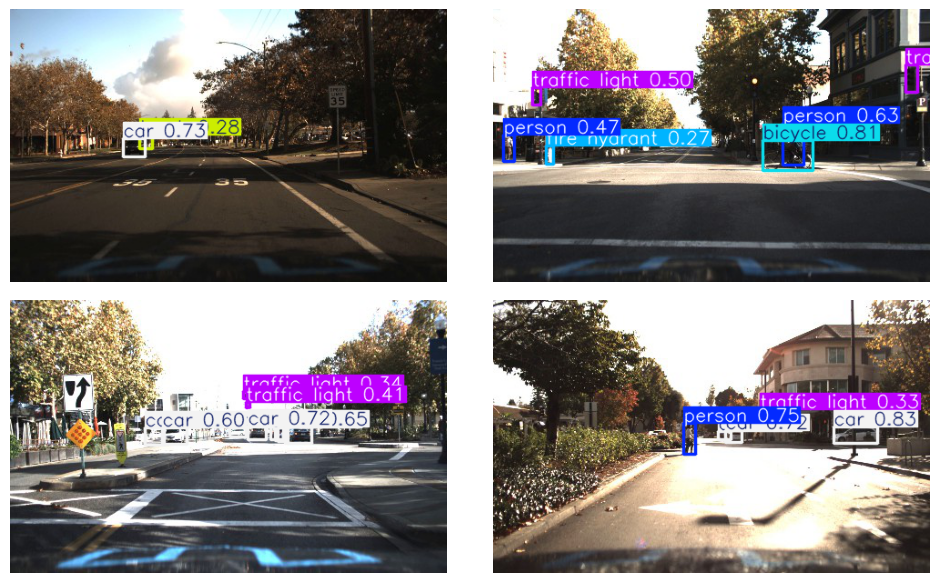

In [50]:
# plotting the images after object detection
print('\n\n-------------------------------------- Images after object detection with YOLOV8 --------------------------------')

plt.figure(figsize=(10,6))
for i, img in enumerate(images):
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)
    plt.axis('off')
plt.tight_layout()
plt.show()

libpng warning: iCCP: known incorrect sRGB profile


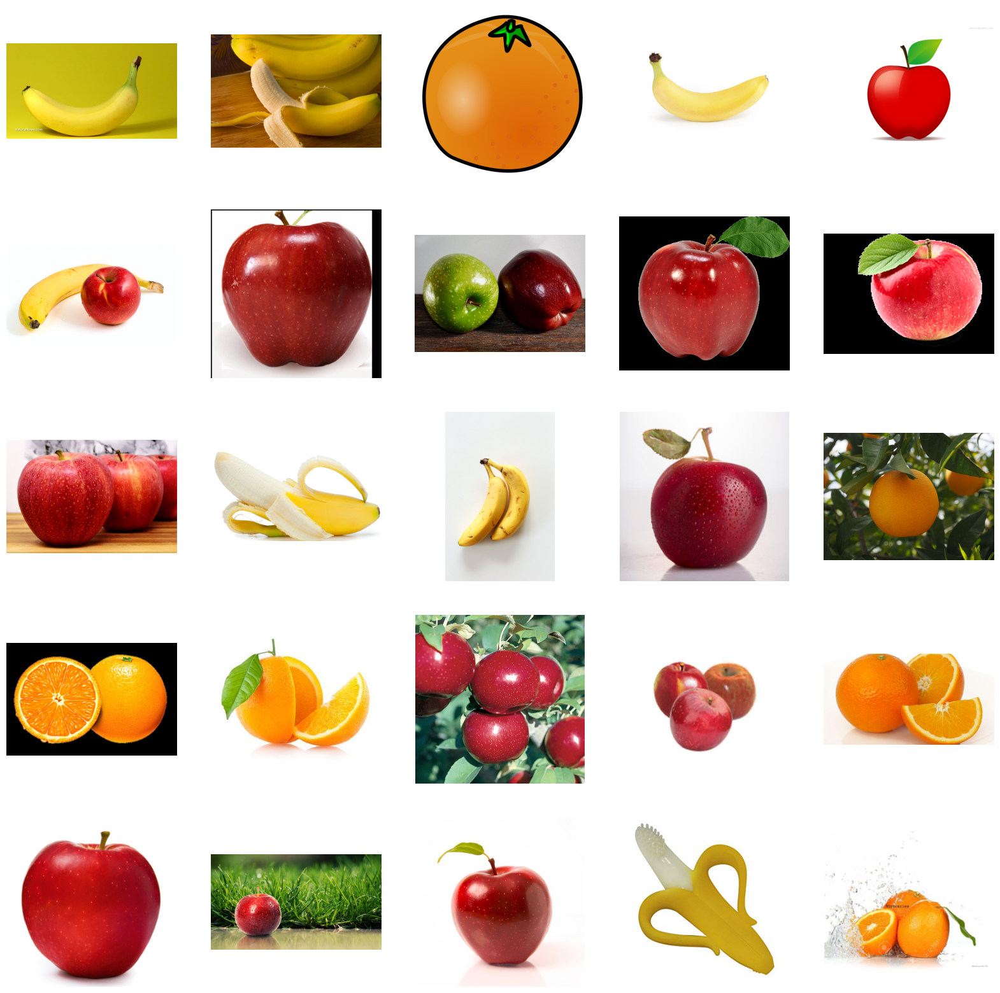

In [51]:
root_path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/*'
num_samples = 25
images_data = glob(root_path)
random_image = random.sample(images_data, num_samples)

plt.figure(figsize=(20,20))
for i in range(num_samples):
    plt.subplot(5,5,i+1)
    plt.imshow(cv2.cvtColor(cv2.imread(random_image[i], cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB))
    plt.axis('off')


In [52]:
# Create a list to store the images
images = []
for i in range(num_samples):
    yolo_outputs = yolo_model.predict(random_image[i])
    output = yolo_outputs[0]
    box = output.boxes
    names = output.names

    for j in range(len(box)):
        labels = names[box.cls[j].item()]
        coordinates = box.xyxy[j].tolist()
        confidence = np.round(box.conf[j].item(), 2)
        #print(f'In this image {len(box)} objects has been detected.')
        print(f'Object {j + 1} is: {labels}')
        print(f'Coordinates are: {coordinates}')
        print(f'Confidence is: {confidence}')
        print('-------')

    # Store the image in the 'images' list
    images.append(output.plot()[:, :, ::-1])



image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/banana_62.jpg: 384x640 1 banana, 714.6ms
Speed: 2.8ms preprocess, 714.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: banana
Coordinates are: [60.813568115234375, 49.0704345703125, 506.8572692871094, 352.16357421875]
Confidence is: 0.97
-------

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/banana_74.jpg: 448x640 6 bananas, 754.9ms
Speed: 1.7ms preprocess, 754.9ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Object 1 is: banana
Coordinates are: [81.0475845336914, 0.8759365081787109, 708.24755859375, 194.70889282226562]
Confidence is: 0.64
-------
Object 2 is: banana
Coordinates are: [294.4498596191406, 228.7699432373047, 720.0, 433.1654968261719]
Confidence is: 0.59
-------
Object 3 is: banana
Coordinates are: [165.16819763183594, 99.04490661621094, 717.4891967773438, 46

libpng warning: iCCP: known incorrect sRGB profile


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_28.jpg: 640x640 1 apple, 1140.4ms
Speed: 2.2ms preprocess, 1140.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [25.309093475341797, 25.283601760864258, 271.7937316894531, 285.3544006347656]
Confidence is: 0.94
-------

Speed: 2.2ms preprocess, 1140.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [25.309093475341797, 25.283601760864258, 271.7937316894531, 285.3544006347656]
Confidence is: 0.94
-------

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_39.jpg: 384x640 2 apples, 685.4ms
Speed: 2.7ms preprocess, 685.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: apple
Coordinates are: [188.4946746826172, 310.71185302734375, 566.6504516601562, 656.8109741210938]
Confidence i

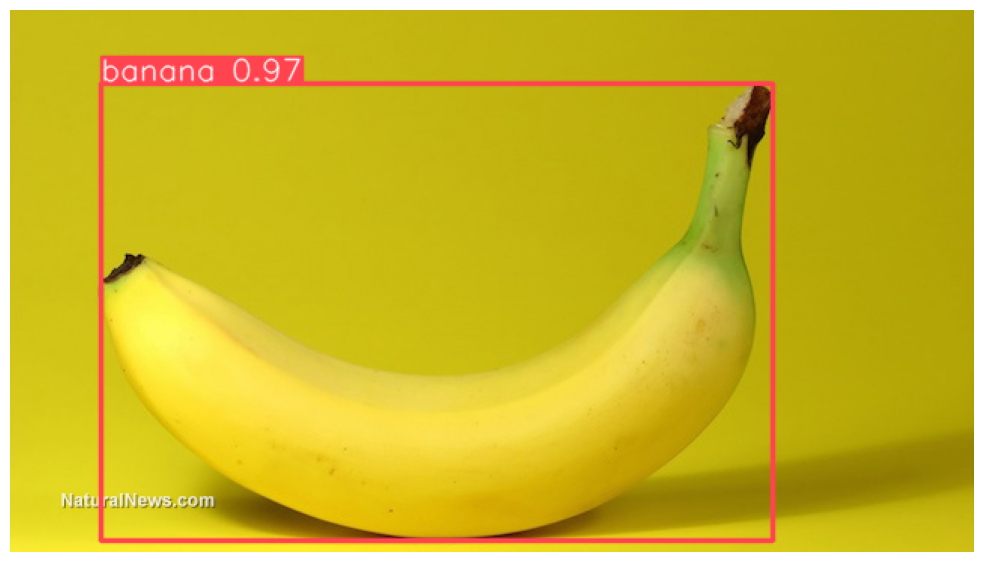

In [53]:
plt.figure(figsize=(10,10))
plt.imshow(images[0])
plt.axis('off')
plt.tight_layout()
plt.show()



-------------------------------------- Images after object detection with YOLOV8 --------------------------------


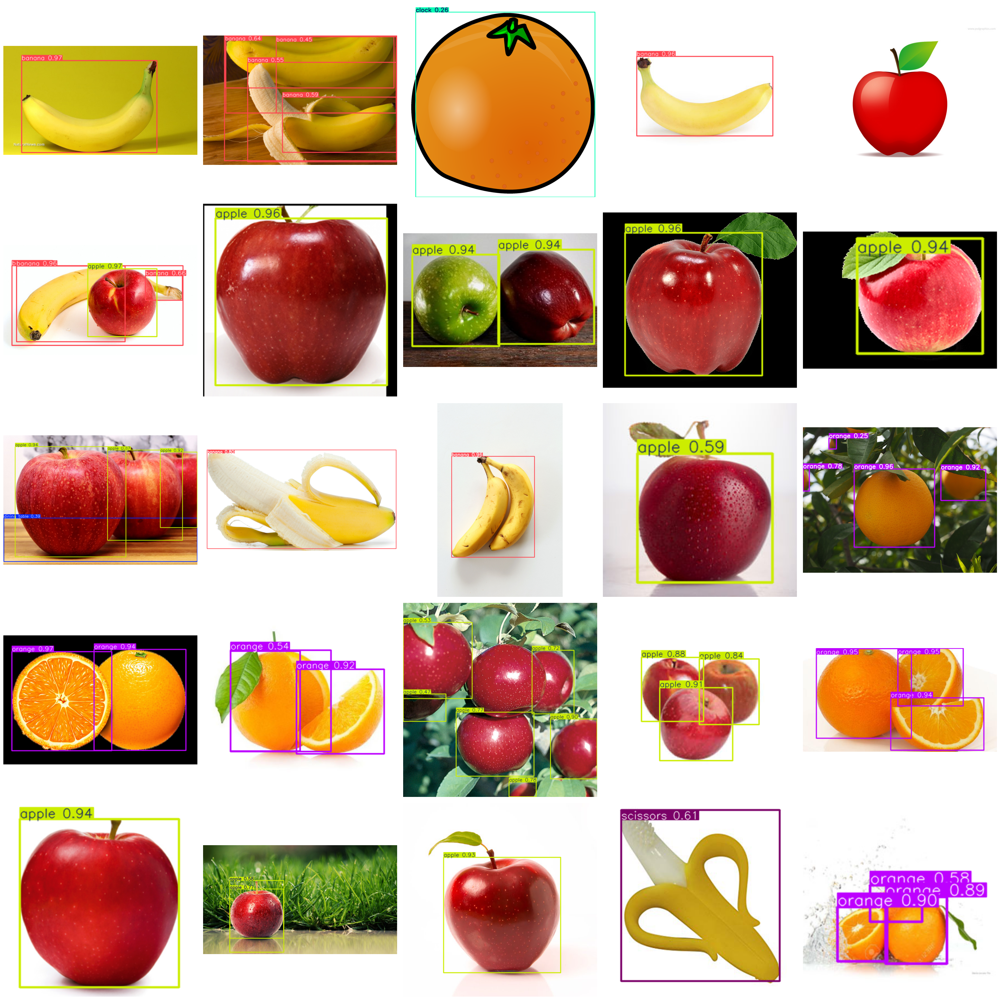

In [54]:
# plotting the images after object detection
print('\n\n-------------------------------------- Images after object detection with YOLOV8 --------------------------------')

plt.figure(figsize=(30,30))
for i, img in enumerate(images):
    plt.subplot(5,5, i + 1)
    plt.imshow(img)
    plt.axis('off')
plt.tight_layout()
plt.show()

In [55]:
def ODImage(image) :
  yolo_outputs = yolo_model.predict(image)
  output = yolo_outputs[0]
  box = output.boxes
  names = output.names
  for j in range(len(box)):
    labels = names[box.cls[j].item()]
    coordinates = box.xyxy[j].tolist()
    confidence = np.round(box.conf[j].item(), 2)
    print(f'Object {j + 1} is: {labels}')
    print(f'Coordinates are: {coordinates}')
    print(f'Confidence is: {confidence}')
    print('-------')
  NewImage = output.plot()[:, :, ::-1]
  plt.figure(figsize=(10,5))
  plt.subplot(1,2,1)
  plt.imshow(cv2.cvtColor(cv2.imread(image, cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB))
  plt.title('Original Image')
  plt.axis('off')
  plt.subplot(1,2,2)
  plt.imshow(NewImage)
  plt.axis('off')
  plt.title('OD Image')
  plt.show()

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_1.jpg: 640x640 1 apple, 1321.2ms
Speed: 3.9ms preprocess, 1321.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [26.148340225219727, 58.18088912963867, 309.49652099609375, 339.60260009765625]
Confidence is: 0.95
-------


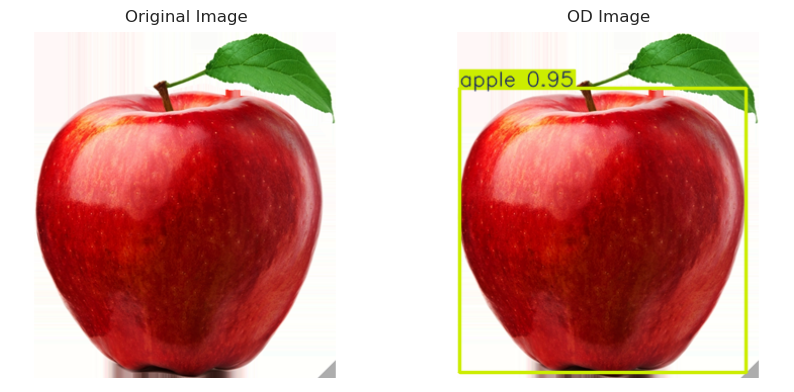

In [56]:
ODImage('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_1.jpg')


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_10.jpg: 640x640 1 apple, 1188.3ms
Speed: 3.9ms preprocess, 1188.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [122.87306213378906, 147.65452575683594, 1417.835205078125, 1421.5810546875]
Confidence is: 0.94
-------


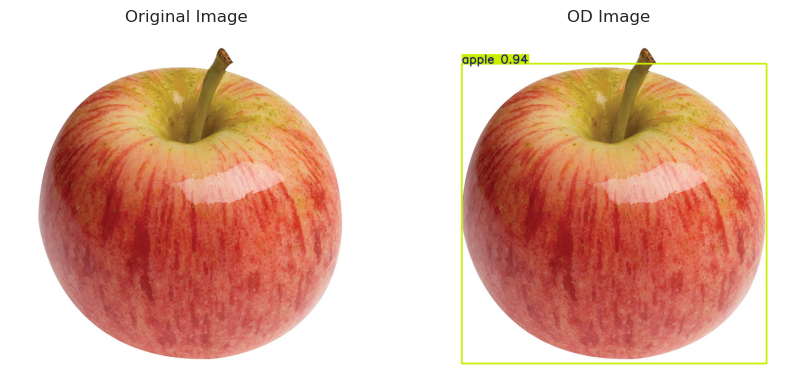

In [57]:
ODImage('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_10.jpg')


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_49.jpg: 640x608 (no detections), 1264.4ms
Speed: 2.2ms preprocess, 1264.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 608)


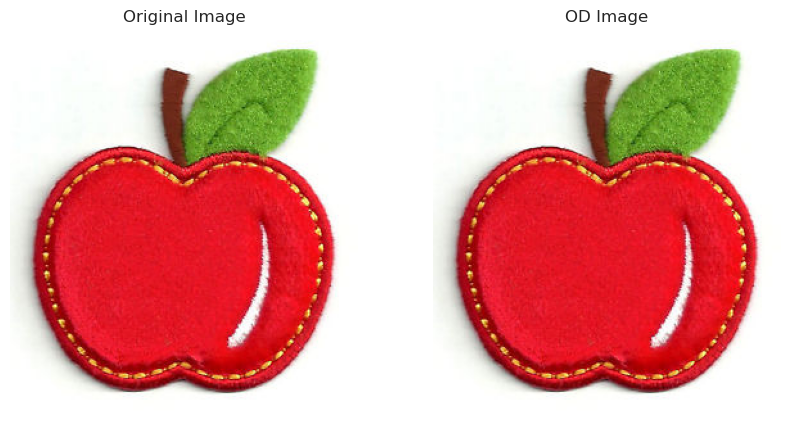

In [58]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_23.jpg: 640x640 3 apples, 1285.1ms
Speed: 2.8ms preprocess, 1285.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [146.5581512451172, 218.03131103515625, 334.7020568847656, 406.6037292480469]
Confidence is: 0.91
-------
Object 2 is: apple
Coordinates are: [99.20304107666016, 140.077880859375, 259.95751953125, 305.01556396484375]
Confidence is: 0.88
-------
Object 3 is: apple
Coordinates are: [248.60964965820312, 144.58642578125, 402.81707763671875, 313.2081604003906]
Confidence is: 0.84
-------


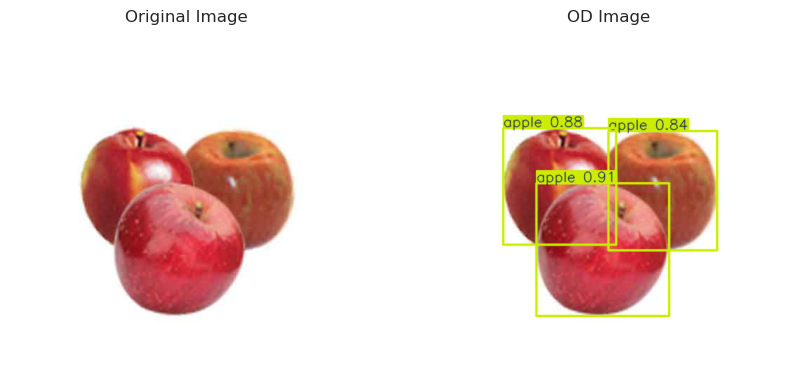

In [59]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_44.jpg: 640x640 1 apple, 1274.0ms
Speed: 3.6ms preprocess, 1274.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [21.624446868896484, 25.047199249267578, 319.14581298828125, 315.233642578125]
Confidence is: 0.96
-------


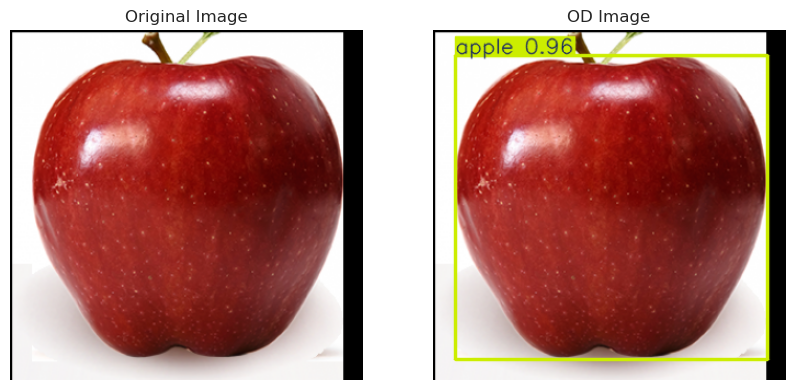

In [60]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits/apple_30.jpg: 640x640 6 apples, 1156.6ms
Speed: 3.1ms preprocess, 1156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Object 1 is: apple
Coordinates are: [607.4406127929688, 478.4809875488281, 799.6957397460938, 725.4251708984375]
Confidence is: 0.9
-------
Object 2 is: apple
Coordinates are: [436.4188232421875, 738.9990234375, 548.6868286132812, 799.6609497070312]
Confidence is: 0.78
-------
Object 3 is: apple
Coordinates are: [218.92616271972656, 450.6999816894531, 539.0159301757812, 714.0919189453125]
Confidence is: 0.77
-------
Object 4 is: apple
Coordinates are: [531.3077392578125, 195.2830047607422, 704.968505859375, 457.32464599609375]
Confidence is: 0.72
-------
Object 5 is: apple
Coordinates are: [0.13856887817382812, 80.50919342041016, 284.73248291015625, 394.6282958984375]
Confidence is: 0.53
-------
Object 6 is: apple
Coordinates are: [0.4243850708

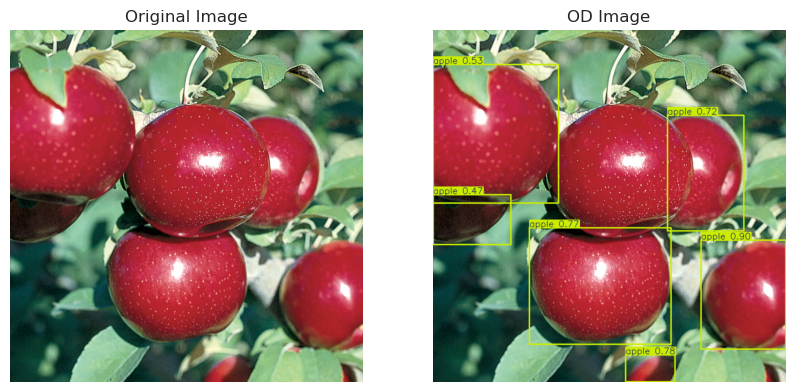

In [61]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/fruits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/streets/vid_4_10900.jpg: 384x640 1 car, 808.3ms
Speed: 2.8ms preprocess, 808.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: car
Coordinates are: [652.4700927734375, 192.6605682373047, 675.298583984375, 200.3394012451172]
Confidence is: 0.62
-------


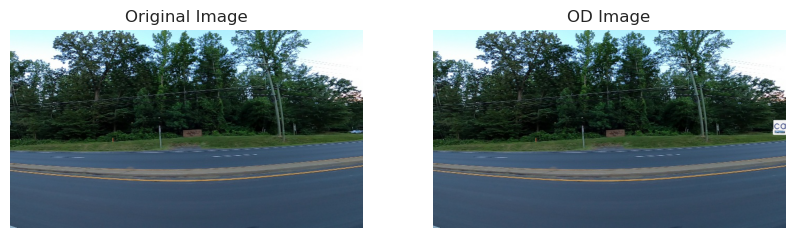

In [62]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/streets'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/streets/vid_4_11060.jpg: 384x640 1 car, 846.5ms
Speed: 1.8ms preprocess, 846.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: car
Coordinates are: [427.122314453125, 192.35812377929688, 445.535888671875, 202.96536254882812]
Confidence is: 0.33
-------


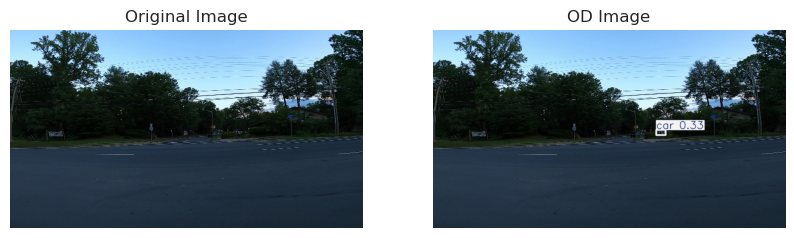

In [63]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/streets'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/streets/vid_4_10140.jpg: 384x640 1 car, 752.8ms
Speed: 1.7ms preprocess, 752.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: car
Coordinates are: [0.11834783107042313, 201.19073486328125, 78.11376190185547, 233.0940704345703]
Confidence is: 0.89
-------


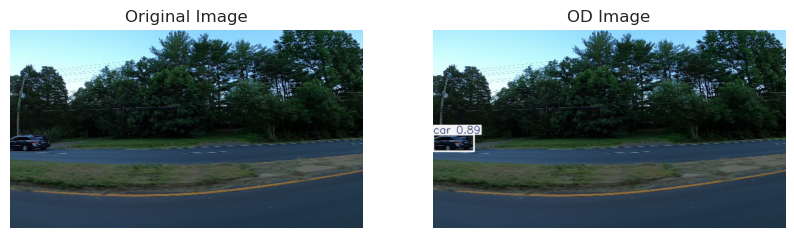

In [64]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/streets'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/digits/_20170531_115031.JPG: 288x640 (no detections), 594.8ms
Speed: 1.7ms preprocess, 594.8ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)


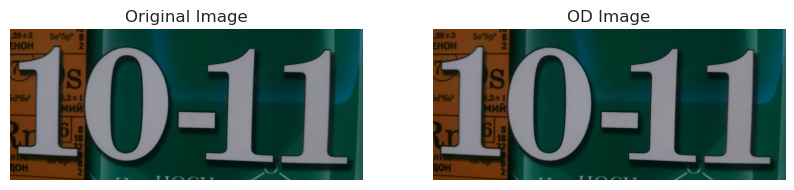

In [65]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/digits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/digits/_20170531_152631.JPG: 416x640 1 stop sign, 801.8ms
Speed: 2.7ms preprocess, 801.8ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)
Object 1 is: stop sign
Coordinates are: [463.523681640625, 210.24752807617188, 2074.52783203125, 1170.4832763671875]
Confidence is: 0.62
-------


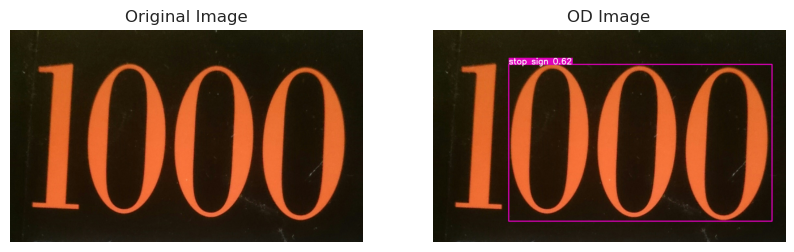

In [66]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/digits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/digits/_20170531_151158.JPG: 384x640 (no detections), 789.8ms
Speed: 2.9ms preprocess, 789.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


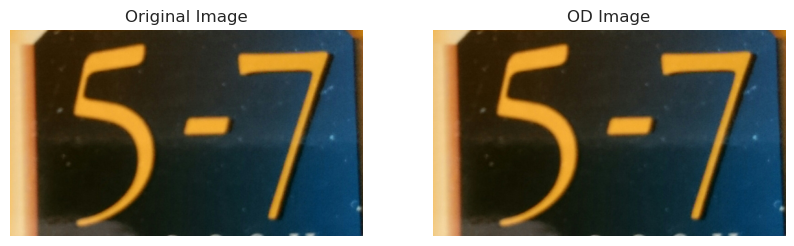

In [67]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/digits'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones/52.JPEG: 384x640 1 airplane, 1 tv, 713.9ms
Speed: 2.2ms preprocess, 713.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: airplane
Coordinates are: [941.6636962890625, 431.13299560546875, 1177.1380615234375, 638.7860107421875]
Confidence is: 0.95
-------
Object 2 is: tv
Coordinates are: [1241.816162109375, 701.6066284179688, 1919.04638671875, 1084.37255859375]
Confidence is: 0.92
-------


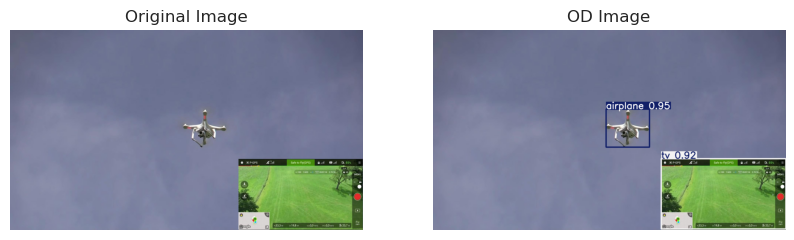

In [68]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones/67.JPEG: 384x640 1 person, 1 tv, 724.1ms
Speed: 3.4ms preprocess, 724.1ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: person
Coordinates are: [1439.3232421875, 229.48526000976562, 1777.4505615234375, 1080.680908203125]
Confidence is: 0.93
-------
Object 2 is: tv
Coordinates are: [1573.921142578125, 288.42510986328125, 1636.8427734375, 371.5244140625]
Confidence is: 0.4
-------


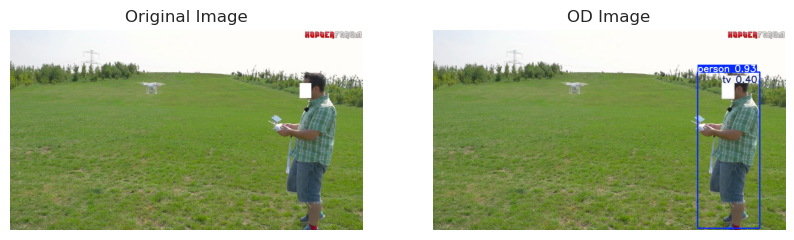

In [69]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones/37.JPEG: 384x640 3 persons, 1 chair, 829.7ms
Speed: 2.8ms preprocess, 829.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: person
Coordinates are: [1101.1124267578125, 369.8989562988281, 1356.12451171875, 1066.13720703125]
Confidence is: 0.9
-------
Object 2 is: person
Coordinates are: [1442.97802734375, 426.8031005859375, 1545.418212890625, 679.8993530273438]
Confidence is: 0.71
-------
Object 3 is: person
Coordinates are: [842.9939575195312, 434.6573486328125, 905.6028442382812, 649.6614990234375]
Confidence is: 0.68
-------
Object 4 is: chair
Coordinates are: [736.1895141601562, 578.0322875976562, 807.0972900390625, 626.2218017578125]
Confidence is: 0.51
-------


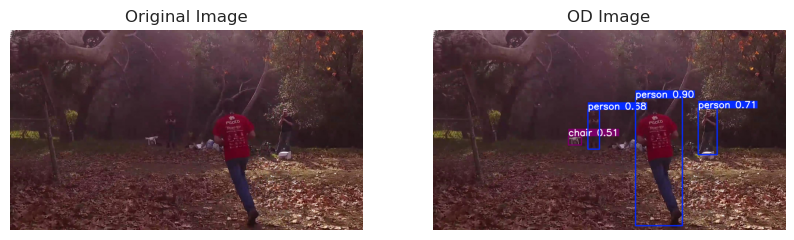

In [70]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones/26.JPEG: 384x640 1 airplane, 806.5ms
Speed: 2.2ms preprocess, 806.5ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: airplane
Coordinates are: [817.2601318359375, 51.16941833496094, 1070.8656005859375, 221.17242431640625]
Confidence is: 0.85
-------


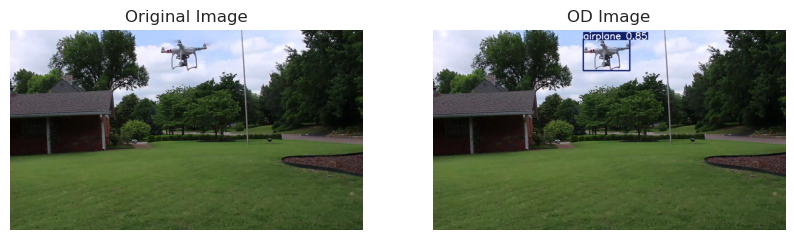

In [71]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/drones'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/flowers/0038.jpg: 480x640 (no detections), 1077.5ms
Speed: 3.6ms preprocess, 1077.5ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


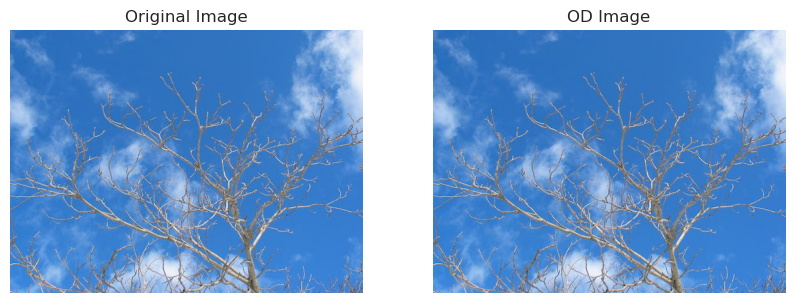

In [72]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/flowers'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/flowers/0040.jpg: 480x640 (no detections), 893.3ms
Speed: 3.3ms preprocess, 893.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


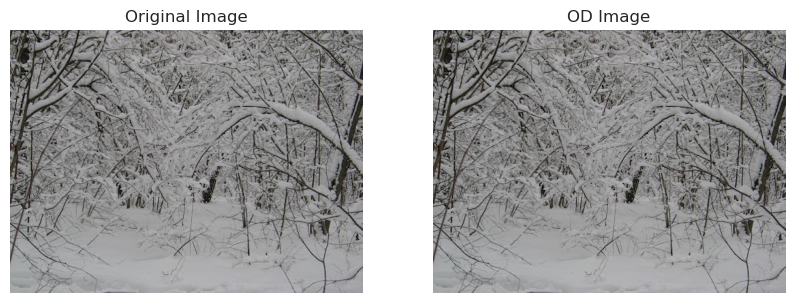

In [73]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/flowers'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/guns/11.jpeg: 384x640 2 persons, 711.7ms
Speed: 2.2ms preprocess, 711.7ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: person
Coordinates are: [124.57833099365234, 0.7617033123970032, 254.91273498535156, 164.61285400390625]
Confidence is: 0.37
-------
Object 2 is: person
Coordinates are: [72.73906707763672, 112.93138122558594, 80.33454132080078, 128.1053009033203]
Confidence is: 0.29
-------


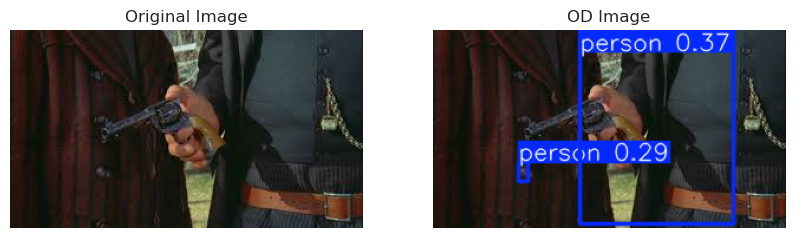

In [74]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/guns'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/guns/55.jpeg: 384x640 1 person, 671.6ms
Speed: 1.4ms preprocess, 671.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Object 1 is: person
Coordinates are: [34.94535827636719, 6.769623279571533, 224.0678253173828, 165.9909210205078]
Confidence is: 0.94
-------


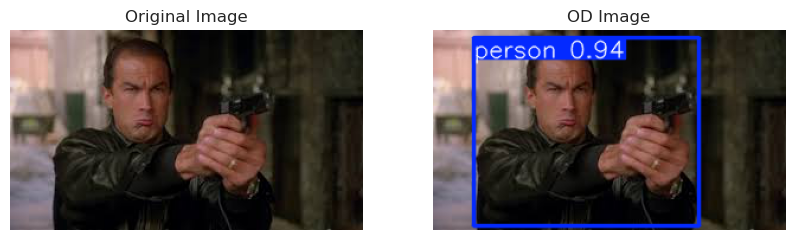

In [75]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/guns'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/guns/12.jpeg: 480x640 1 person, 972.7ms
Speed: 2.6ms preprocess, 972.7ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
Object 1 is: person
Coordinates are: [1.550379991531372, 0.3479635715484619, 256.9234924316406, 189.74546813964844]
Confidence is: 0.73
-------


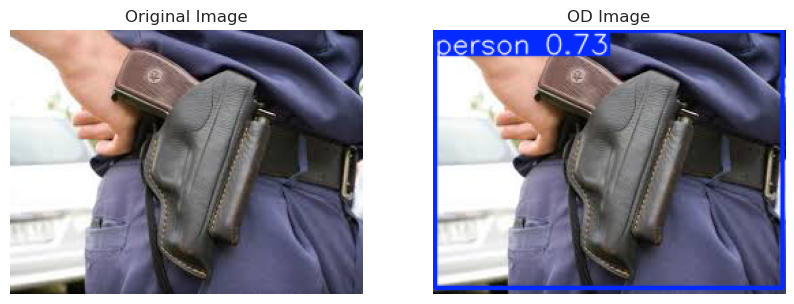

In [76]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/guns'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People/00000849.jpg: 640x416 1 person, 907.7ms
Speed: 3.5ms preprocess, 907.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Object 1 is: person
Coordinates are: [171.00741577148438, 33.320899963378906, 484.8363342285156, 992.2535400390625]
Confidence is: 0.96
-------


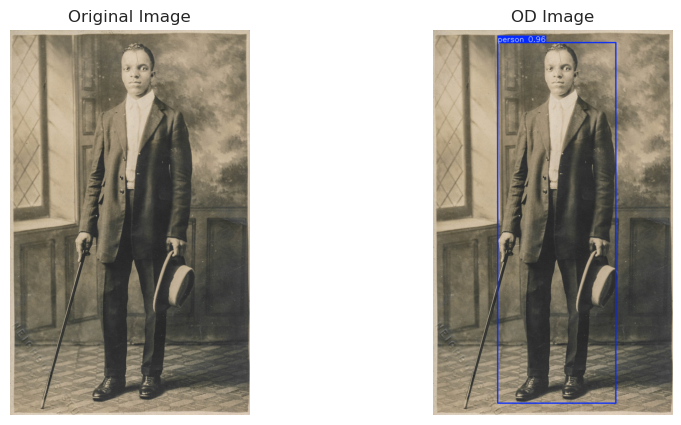

In [77]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People/00000850.jpg: 448x640 11 persons, 1 traffic light, 2 backpacks, 805.0ms
Speed: 2.1ms preprocess, 805.0ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)
Object 1 is: person
Coordinates are: [31.205947875976562, 98.26324462890625, 377.5436096191406, 395.2789611816406]
Confidence is: 0.95
-------
Object 2 is: person
Coordinates are: [356.2758483886719, 212.31187438964844, 395.78692626953125, 313.6097412109375]
Confidence is: 0.78
-------
Object 3 is: person
Coordinates are: [475.610107421875, 205.83811950683594, 516.2824096679688, 322.5241394042969]
Confidence is: 0.77
-------
Object 4 is: person
Coordinates are: [441.7630310058594, 213.29501342773438, 483.10858154296875, 327.0487365722656]
Confidence is: 0.75
-------
Object 5 is: person
Coordinates are: [333.365234375, 213.1651611328125, 356.78265380859375, 292.1591491699219]
Confidence is: 0.73
-------
Object 6 is:

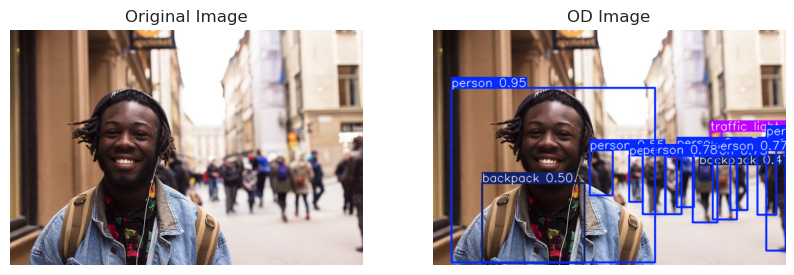

In [78]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People/00000876.jpg: 512x640 1 person, 1 sandwich, 1039.2ms
Speed: 4.3ms preprocess, 1039.2ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)
Object 1 is: person
Coordinates are: [242.0874481201172, 50.23927688598633, 1276.19921875, 1044.14892578125]
Confidence is: 0.97
-------
Object 2 is: sandwich
Coordinates are: [485.6893310546875, 589.3239135742188, 661.7286376953125, 716.2203369140625]
Confidence is: 0.89
-------


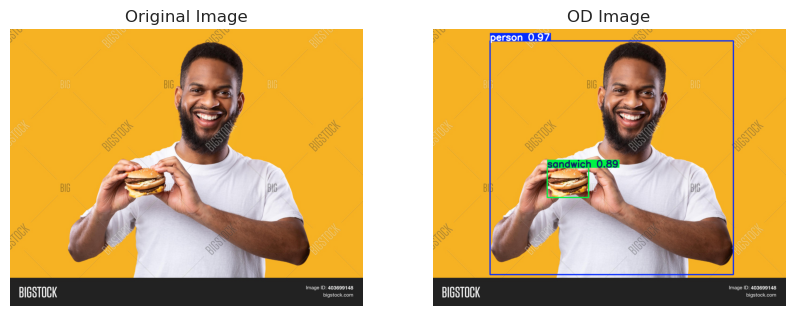

In [79]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People/00000845.jpg: 480x640 1 person, 1055.3ms
Speed: 4.0ms preprocess, 1055.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
Object 1 is: person
Coordinates are: [96.36740112304688, 28.773534774780273, 432.9549560546875, 417.6180419921875]
Confidence is: 0.95
-------


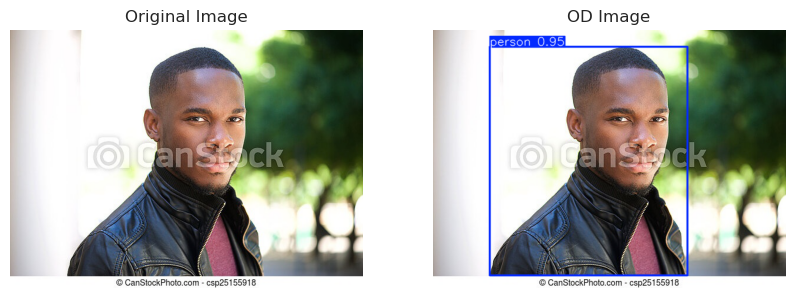

In [80]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))


image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People/00000844.jpg: 512x640 1 person, 2 cell phones, 977.2ms
Speed: 2.2ms preprocess, 977.2ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)
Object 1 is: person
Coordinates are: [135.0628204345703, 6.595771789550781, 339.41693115234375, 260.79998779296875]
Confidence is: 0.96
-------
Object 2 is: cell phone
Coordinates are: [192.47589111328125, 144.77952575683594, 220.2766571044922, 174.79067993164062]
Confidence is: 0.84
-------
Object 3 is: cell phone
Coordinates are: [238.3948211669922, 44.47055435180664, 256.49871826171875, 61.96424865722656]
Confidence is: 0.32
-------


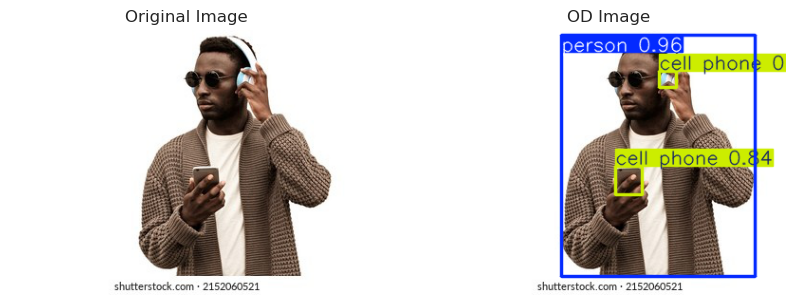

In [81]:
Path = '/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/People'
ODImage(os.path.join(Path, np.random.choice(os.listdir(Path))))

# OCR


# OCR

Computer vision and Optical Character Recognition (OCR) are closely related fields in artificial intelligence that deal with interpreting visual information and extracting text from images, respectively.
OCR is an advanced technique from the object detection 


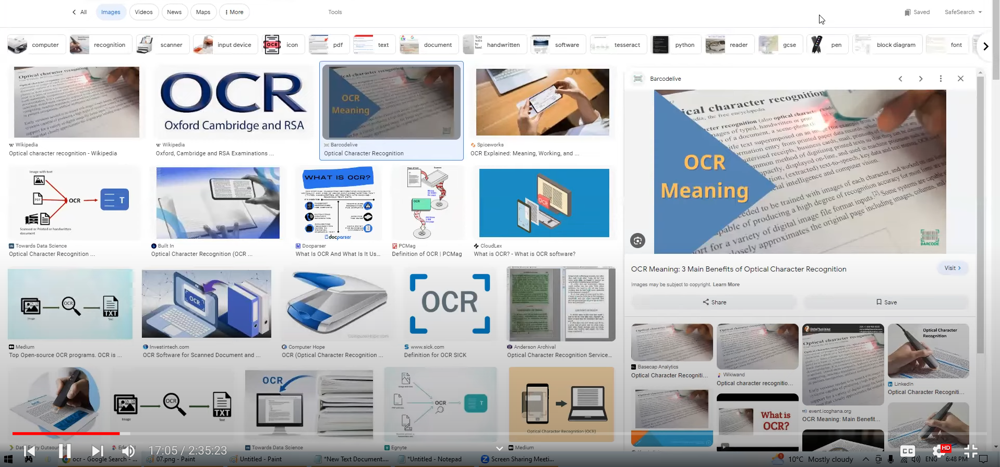

## Computer Vision

### Definition:
    Computer vision is a field of artificial intelligence that enables computers to interpret and make decisions based on visual data. The goal is to automate tasks that the human visual system can do.

### Key Concepts:
    Image Processing: 
        Techniques to enhance raw images, such as filtering, edge detection, and noise reduction.
    Feature Extraction: 
        Identifying and isolating various features (edges, corners, textures) in the image.
    Object Detection and Recognition: 
        Identifying and classifying objects within an image.
    Image Segmentation:     
        Dividing an image into multiple parts or regions for easier analysis.
    Pattern Recognition:    
        Recognizing patterns and regularities in data, often used in object recognition.
    3D Vision: 
        Understanding three-dimensional structure from 2D images, often involving depth perception techniques like stereopsis.

## Applications:
    Autonomous vehicles (self-driving cars)
    Facial recognition systems
    Medical image analysis
    Industrial automation (defect detection)
    Augmented reality





## Optical Character Recognition (OCR)

### Definition:
    OCR is a technology used to convert different types of documents, such as scanned paper documents, PDFs, or images taken by a digital camera, into editable and searchable data.

### Key Concepts:
    Preprocessing: 
        Steps to prepare the image for OCR, including noise reduction, binarization, skew correction, and normalization.
    Text Detection: 
        Identifying the regions of the image that contain text.
    Character Segmentation: 
        Dividing text into individual characters for easier recognition.
    Character Recognition: 
        Classifying each character into one of the known character classes. This is often done using machine learning models like Convolutional Neural Networks (CNNs).
    Post-processing: 
        Correcting errors and formatting the recognized text into a readable format.

### Applications:
    Digitizing printed documents
    Automated data entry
    License plate recognition
    Assistive technology for visually impaired individuals
    Archiving historical documents
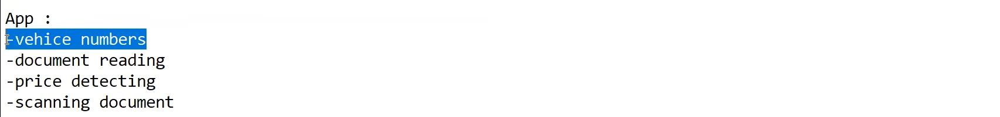
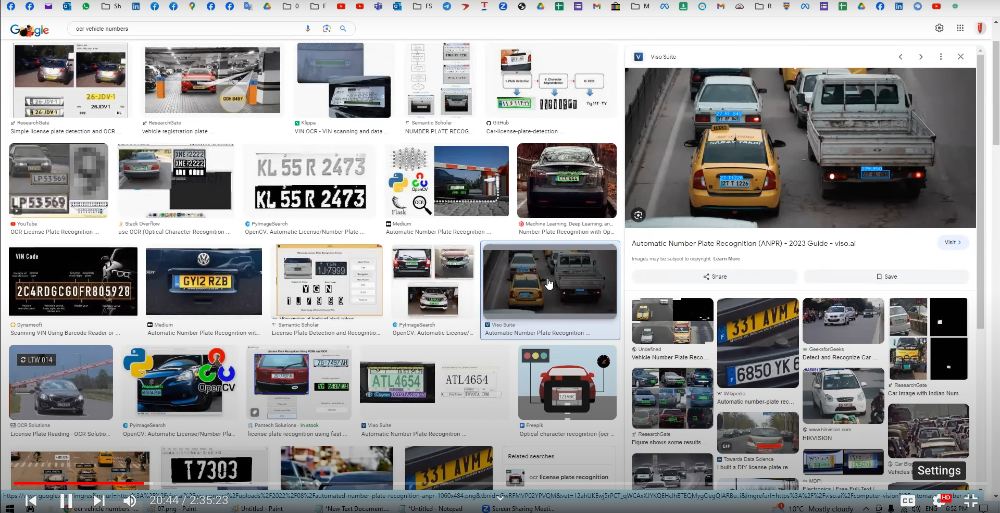
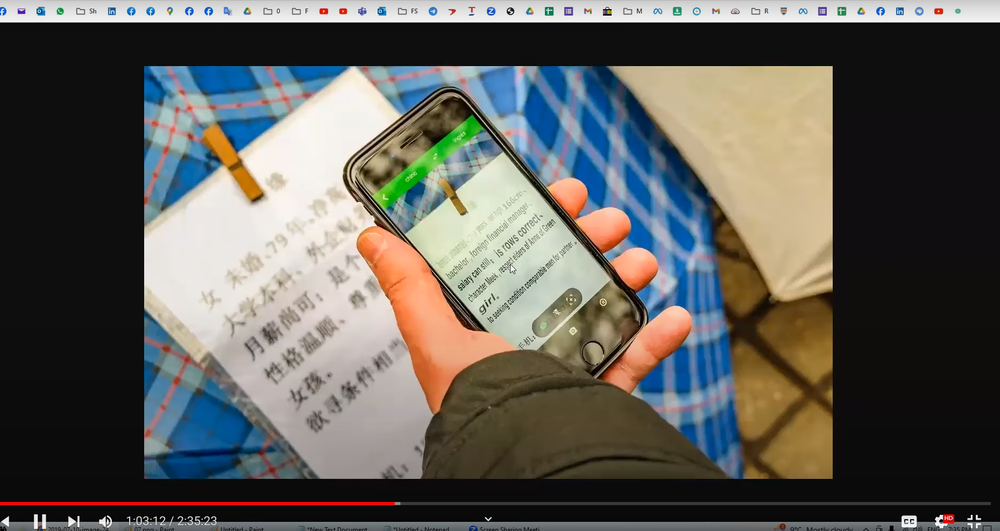

## Tools and Libraries
    Computer Vision Libraries:
        OpenCV: An open-source computer vision and machine learning software library.
        TensorFlow/Keras: Deep learning libraries that can be used for building and training computer vision models.
        PyTorch: Another popular deep learning framework for computer vision tasks.
        scikit-image: A collection of algorithms for image processing in Python.

    OCR Libraries:
        Tesseract: An open-source OCR engine that supports multiple languages.
        OCRopus: A collection of document analysis programs.
        EasyOCR: A Python library built on PyTorch, designed for OCR.
        Google Cloud Vision OCR: A cloud-based OCR service that can handle a wide variety of languages and document types.

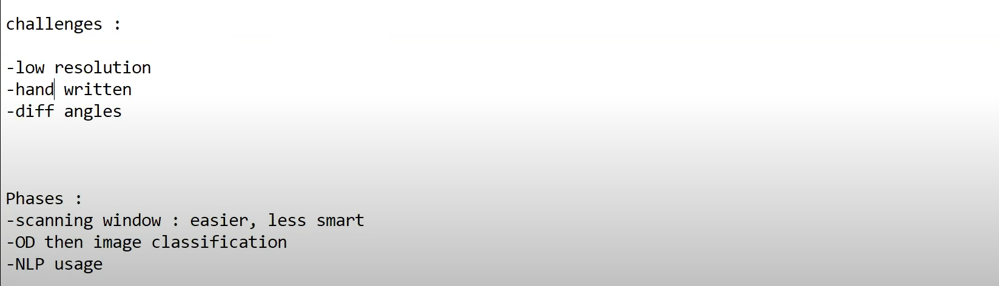

## phases of OCR
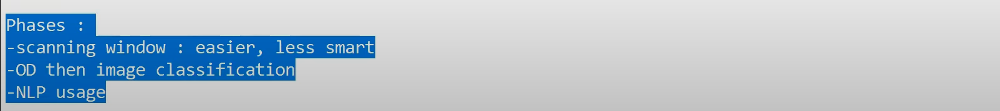
    1-


    2-


    3-


## APP1

# Modified National Institute of Standards and Technology
https://www.kaggle.com/yassineghouzam/introduction-to-cnn-keras-0-997-top-6



In [82]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
%matplotlib inline

np.random.seed(2)

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import itertools
import tensorflow
from tensorflow.keras.utils import to_categorical # convert to one-hot-encoding
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from keras.optimizers import RMSprop
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ReduceLROnPlateau


sns.set(style='white', context='notebook', palette='deep')

In [83]:
# Load the data
train = pd.read_csv("/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/data/mnist/train.csv")
test = pd.read_csv("/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/data/mnist/test.csv")

In [84]:
train.shape

(42000, 785)

In [85]:
Y_train = train["label"]

# Drop 'label' column
X_train = train.drop(labels = ["label"],axis = 1)

# free some space
# del train

Y_train.value_counts()

label
1    4684
7    4401
3    4351
9    4188
2    4177
6    4137
0    4132
4    4072
8    4063
5    3795
Name: count, dtype: int64

In [86]:

# Check the data
X_train.isnull().any().describe()

count       784
unique        1
top       False
freq        784
dtype: object

In [87]:
test.isnull().any().describe()


count       784
unique        1
top       False
freq        784
dtype: object

In [88]:
# Normalize the data
X_train = X_train / 255.0
test = test / 255.0

In [89]:
# Reshape image in 3 dimensions (height = 28px, width = 28px , canal = 1)
X_train = X_train.values.reshape(-1,28,28,1)
test = test.values.reshape(-1,28,28,1)

In [90]:
# Encode labels to one hot vectors (ex : 2 -> [0,0,1,0,0,0,0,0,0,0])
Y_train = to_categorical(Y_train, num_classes = 10)

In [91]:
# Set the random seed
random_seed = 2

In [92]:
# Split the train and the validation set for the fitting
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size = 0.1, random_state=random_seed)

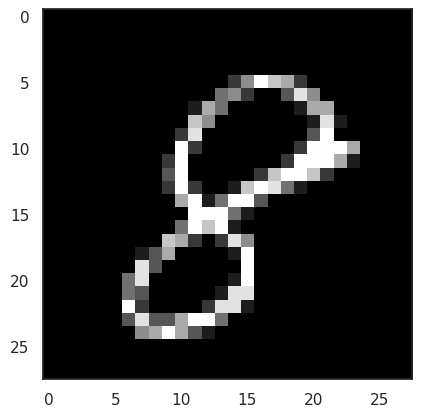

In [93]:
# Some examples
plt.imshow(X_train[0][:,:,0],cmap = 'gray')

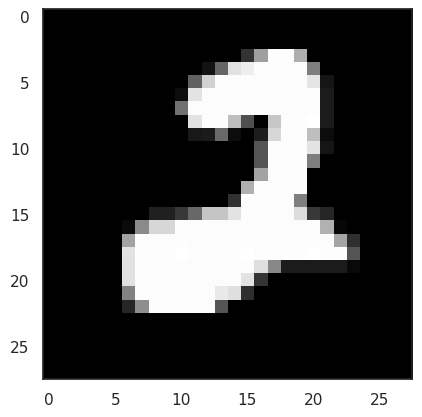

In [94]:
# Some examples
g = plt.imshow(X_train[10][:,:,0],cmap = 'gray')

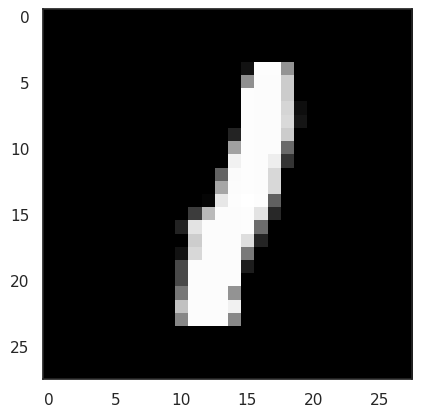

In [95]:
# Some examples
g = plt.imshow(X_train[20][:,:,0],cmap = 'gray')

In [96]:
# Set the CNN model
# my CNN architechture is In -> [[Conv2D->relu]*2 -> MaxPool2D -> Dropout]*2 -> Flatten -> Dense -> Dropout -> Out

model = Sequential()

model.add(Conv2D(filters = 32, kernel_size = (5,5),padding = 'Same',
                 activation ='relu', input_shape = (28,28,1)))
model.add(Conv2D(filters = 32, kernel_size = (5,5),padding = 'Same',
                 activation ='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))


model.add(Conv2D(filters = 64, kernel_size = (3,3),padding = 'Same',
                 activation ='relu'))
model.add(Conv2D(filters = 64, kernel_size = (3,3),padding = 'Same',
                 activation ='relu'))
model.add(MaxPool2D(pool_size=(2,2), strides=(2,2)))
model.add(Dropout(0.25))


model.add(Flatten())
model.add(Dense(256, activation = "relu"))
model.add(Dropout(0.5))
model.add(Dense(10, activation = "softmax"))

In [97]:
# Define the optimizer
optimizer = RMSprop(lr=0.001, rho=0.9, epsilon=1e-08)

In [98]:
# Compile the model
model.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"])


In [99]:
# Set a learning rate annealer
learning_rate_reduction = ReduceLROnPlateau(monitor='val_acc',
                                            patience=3,
                                            verbose=1,
                                            factor=0.5,
                                            min_lr=0.00001)
epochs = 1 # Turn epochs to 30 to get 0.9967 accuracy
batch_size = 86

In [100]:
# With data augmentation to prevent overfitting (accuracy 0.99286)

datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range=10,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.1, # Randomly zoom image
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip=False,  # randomly flip images
        vertical_flip=False)  # randomly flip images


datagen.fit(X_train)

In [101]:
# Fit the model
history = model.fit_generator(datagen.flow(X_train,Y_train, batch_size=batch_size),
                              epochs = epochs, validation_data = (X_val,Y_val),
                              verbose = 2, steps_per_epoch=X_train.shape[0] // batch_size
                              , callbacks=[learning_rate_reduction])

439/439 - 111s - loss: 0.4003 - accuracy: 0.8715 - val_loss: 0.0592 - val_accuracy: 0.9812 - lr: 0.0010 - 111s/epoch - 252ms/step


132/132 [==============================] - 3s 23ms/step


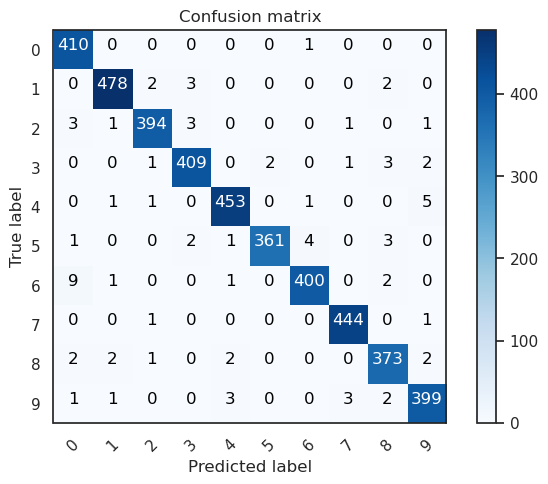

In [102]:
# Look at confusion matrix

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Predict the values from the validation dataset
Y_pred = model.predict(X_val)
# Convert predictions classes to one hot vectors
Y_pred_classes = np.argmax(Y_pred,axis = 1)
# Convert validation observations to one hot vectors
Y_true = np.argmax(Y_val,axis = 1)
# compute the confusion matrix
confusion_mtx = confusion_matrix(Y_true, Y_pred_classes)
# plot the confusion matrix
plot_confusion_matrix(confusion_mtx, classes = range(10))

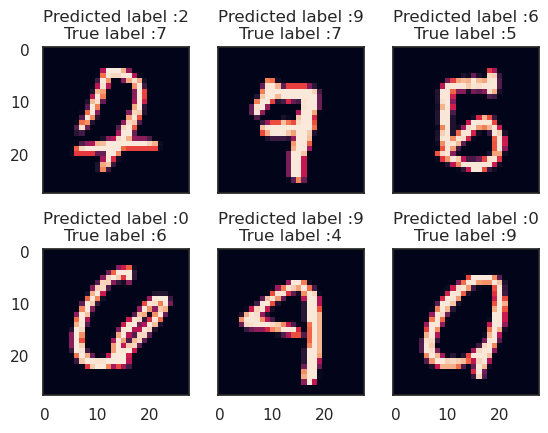

In [103]:
# Display some error results

# Errors are difference between predicted labels and true labels
errors = (Y_pred_classes - Y_true != 0)

Y_pred_classes_errors = Y_pred_classes[errors]
Y_pred_errors = Y_pred[errors]
Y_true_errors = Y_true[errors]
X_val_errors = X_val[errors]

def display_errors(errors_index,img_errors,pred_errors, obs_errors):
    """ This function shows 6 images with their predicted and real labels"""
    n = 0
    nrows = 2
    ncols = 3
    fig, ax = plt.subplots(nrows,ncols,sharex=True,sharey=True)
    for row in range(nrows):
        for col in range(ncols):
            error = errors_index[n]
            ax[row,col].imshow((img_errors[error]).reshape((28,28)))
            ax[row,col].set_title("Predicted label :{}\nTrue label :{}".format(pred_errors[error],obs_errors[error]))
            n += 1

# Probabilities of the wrong predicted numbers
Y_pred_errors_prob = np.max(Y_pred_errors,axis = 1)

# Predicted probabilities of the true values in the error set
true_prob_errors = np.diagonal(np.take(Y_pred_errors, Y_true_errors, axis=1))

# Difference between the probability of the predicted label and the true label
delta_pred_true_errors = Y_pred_errors_prob - true_prob_errors

# Sorted list of the delta prob errors
sorted_dela_errors = np.argsort(delta_pred_true_errors)

# Top 6 errors
most_important_errors = sorted_dela_errors[-6:]

# Show the top 6 errors
display_errors(most_important_errors, X_val_errors, Y_pred_classes_errors, Y_true_errors)

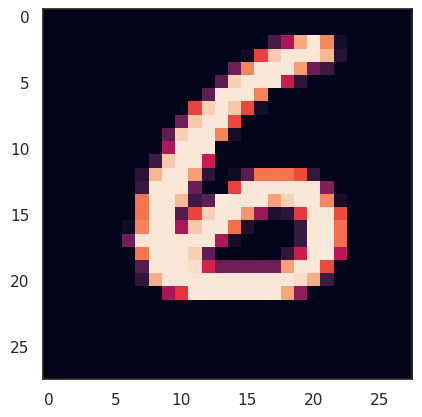

In [104]:
plt.imshow(X_val[0])

In [105]:
model.predict(np.reshape(X_val[0],[1,28,28,1]))

1/1 [==============================] - 0s 33ms/step


array([[ 3.4503e-06,  1.2089e-10,  1.3233e-09,  2.4026e-11,  6.0247e-09,  4.2475e-07,           1,  1.3151e-12,   3.548e-07,  1.0039e-09]], dtype=float32)

In [106]:
np.argmax(model.predict(np.reshape(X_val[0],[1,28,28,1])))

1/1 [==============================] - 0s 26ms/step


6

In [107]:
def PredictImage(Image) :
  print(np.argmax(model.predict(np.reshape(Image,[1,28,28,1]))))
  plt.imshow(Image)


1/1 [==============================] - 0s 27ms/step
6


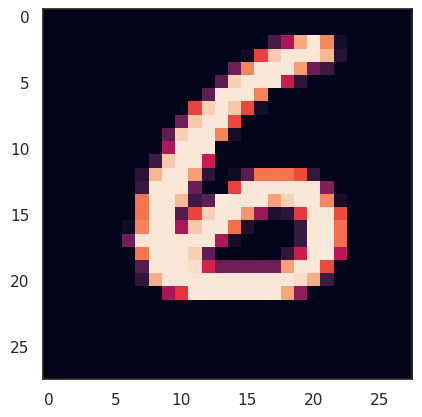

In [108]:
PredictImage(X_val[0])

1/1 [==============================] - 0s 22ms/step
6


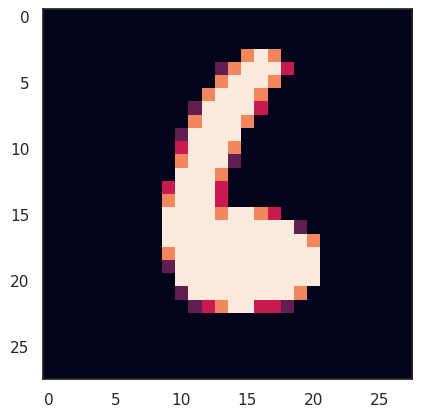

In [109]:
PredictImage(X_val[np.random.randint(1000)])

In [110]:
import cv2

In [113]:
p = cv2.imread('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/03.png', cv2.IMREAD_GRAYSCALE)
p.shape

(106, 110)

In [114]:
p = cv2.resize(p,(28,28))
p.shape

(28, 28)

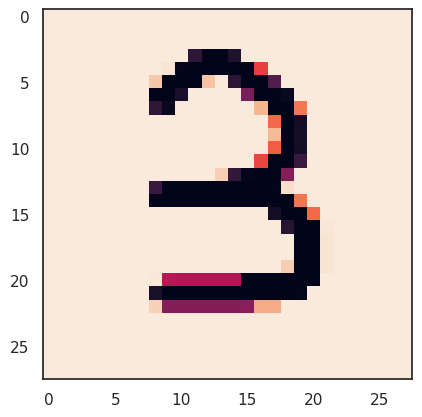

In [115]:
plt.imshow(p)

In [116]:
p = np.reshape(p,[28,28,1])
p.shape

(28, 28, 1)

1/1 [==============================] - 0s 79ms/step
2


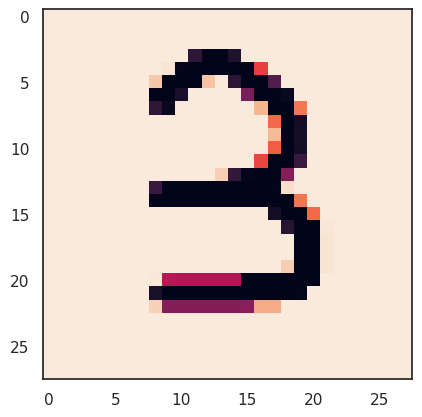

In [117]:
PredictImage(p )

In [118]:
p = cv2.imread('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/02.png', cv2.IMREAD_GRAYSCALE)
p = cv2.resize(p,(28,28))
p.shape

(28, 28)

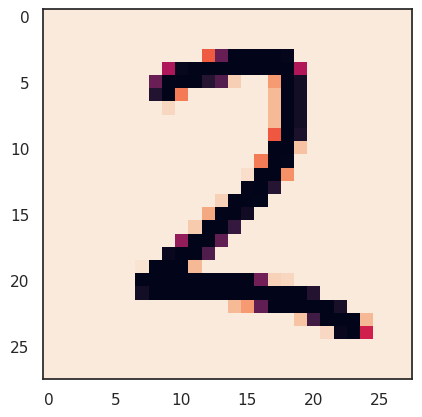

In [119]:
plt.imshow(p)

In [120]:
p = np.reshape(p,[28,28,1])
p.shape

(28, 28, 1)

1/1 [==============================] - 0s 18ms/step
2


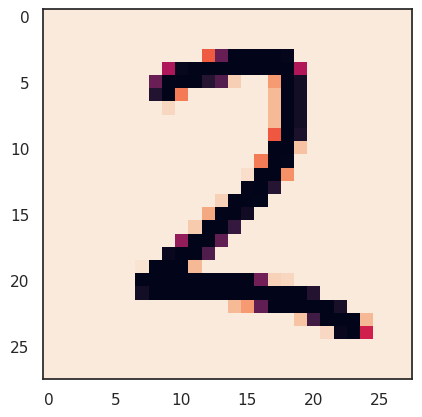

In [121]:
PredictImage(p )

In [122]:
p = cv2.imread('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/05.png', cv2.IMREAD_GRAYSCALE)
p = cv2.resize(p,(28,28))
p.shape

(28, 28)

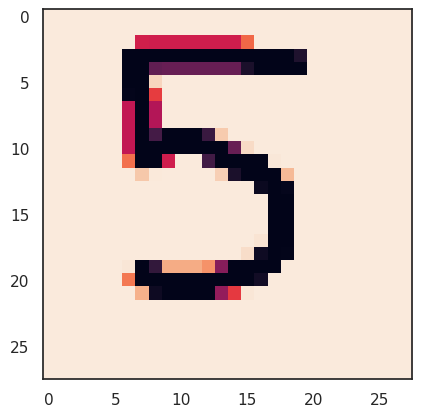

In [123]:
plt.imshow(p)

In [124]:
p = np.reshape(p,[28,28,1])
p.shape

(28, 28, 1)

In [ ]:
PredictImage(p )

In [125]:
p = cv2.imread('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/07.png', cv2.IMREAD_GRAYSCALE)
p = cv2.resize(p,(28,28))
p.shape

(28, 28)

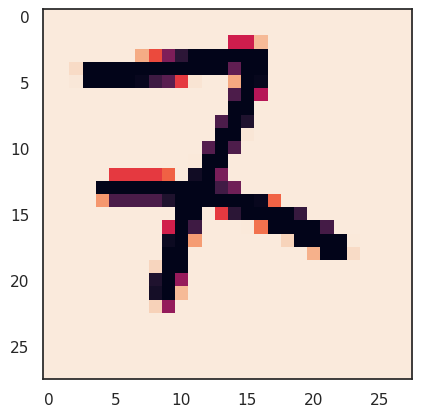

In [126]:
plt.imshow(p)

In [127]:
p = np.reshape(p,[28,28,1])
p.shape

(28, 28, 1)

1/1 [==============================] - 0s 18ms/step
3


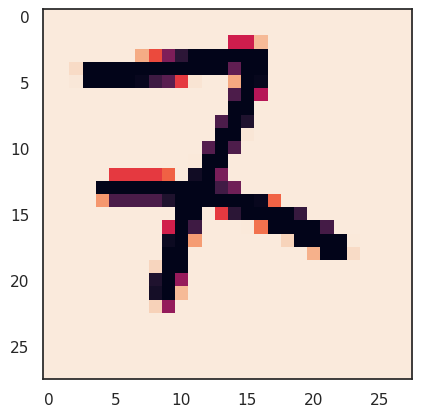

In [128]:
PredictImage(p )

## APP2 # **OCR-pytesseract (Arabic)**

In [130]:
import pandas as pd
import numpy as np

from PIL import Image
from PIL import Image, ImageDraw, ImageFont


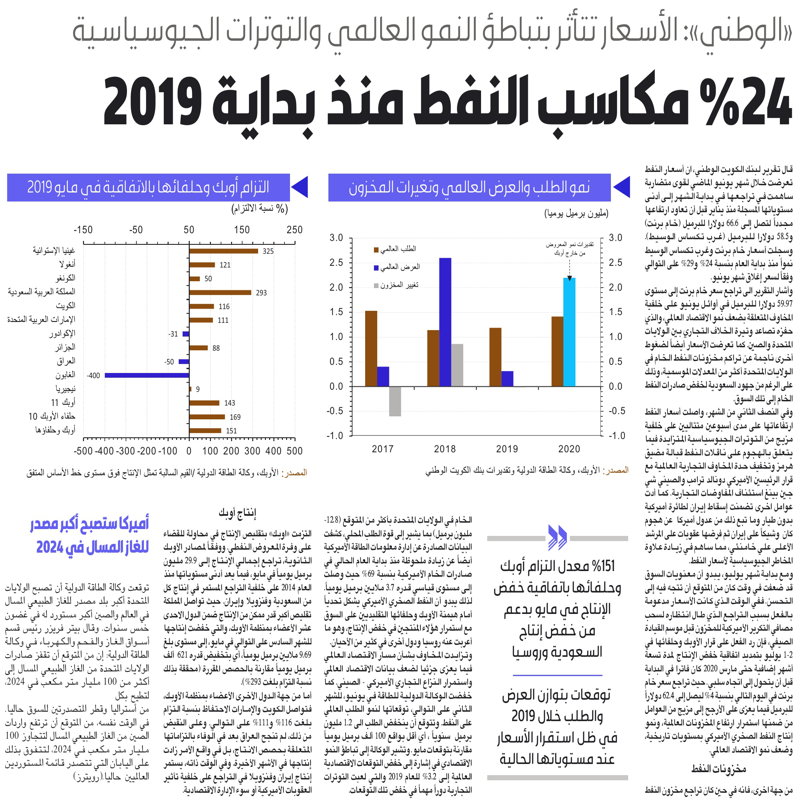

In [131]:
image = Image.open("/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/1.png")
image = image.convert("RGB")
new_image = image.resize((800, 800))
new_image

In [133]:
import shutil
import os
import subprocess
from pdf2image import convert_from_path
from PIL import Image
import pytesseract

src = '../input/papers-images/ara.traineddata'
dest = '/usr/share/tesseract-ocr/4.00/tessdata/'
shutil.copy(src, dest)


src = '../input/papers-images/deu.traineddata'
dest = '/usr/share/tesseract-ocr/4.00/tessdata/'
shutil.copy(src, dest)

src = '../input/papers-images/fra.traineddata'
dest = '/usr/share/tesseract-ocr/4.00/tessdata/'
shutil.copy(src, dest)

filenames = os.listdir('/usr/share/tesseract-ocr/4.00/tessdata/')
print(filenames) # check that the file is added in this directory which was not present before.

FileNotFoundError: [Errno 2] No such file or directory: '../input/papers-images/ara.traineddata'

In [ ]:
# Functions
def ocr_extract(image):
    width, height = image.size
    w_scale = 2000/width
    h_scale = 2000/height

    ocr_df = pytesseract.image_to_data(image, output_type='data.frame', lang='ara+eng+fra+deu') \
    #text3 = pytesseract.image_to_string(image, lang='ara+eng' )


    ocr_df = ocr_df.dropna() \
                   .assign(left_scaled = ocr_df.left*w_scale,
                           width_scaled = ocr_df.width*w_scale,
                           top_scaled = ocr_df.top*h_scale,
                           height_scaled = ocr_df.height*h_scale,
                           right_scaled = lambda x: x.left_scaled + x.width_scaled,
                           bottom_scaled = lambda x: x.top_scaled + x.height_scaled)

    float_cols = ocr_df.select_dtypes('float').columns
    ocr_df[float_cols] = ocr_df[float_cols].round(0).astype(int)
    return ocr_df


In [ ]:
## Arabic Text
image = Image.open("/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/1.png")
ocr_df=ocr_extract(image)
print(ocr_df.shape)
ocr_df.sample(50)

In [ ]:
print(' '.join(ocr_df['text'].tolist()))

In [ ]:
img = Image.open('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/1.png')
img

In [ ]:
img = Image.open('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/1.png')
box = (5, 500, 150, 750)
img2 = img.crop(box)

img2.save('myimage_cropped.jpg')

img = Image.open('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/myimage_cropped.jpg')
img

/home/ahmed-ferganey/anaconda3_new/envs/ml_cv_env/bin/python
3.8.19 (default, Mar 20 2024, 19:58:24) 
[GCC 11.2.0]
PyTorch version: 2.1.0+cu121
torchvision version: 0.16.0+cu121

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/images/1478019956680248165.jpg: 416x640 1 car, 1 truck, 772.6ms
Speed: 5.4ms preprocess, 772.6ms inference, 16.3ms postprocess per image at shape (1, 3, 416, 640)
Object 1 is: car
Coordinates are: [124.68521118164062, 142.70297241210938, 148.6992645263672, 162.04129028320312]
Confidence is: 0.73
-------
Object 2 is: truck
Coordinates are: [142.32627868652344, 138.85707092285156, 156.8897705078125, 153.69163513183594]
Confidence is: 0.28
-------

image 1/1 /media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/09ObjectDetection/OD/images/1478020390703425835.jpg: 416x640 2 persons, 1 bicycle, 2 traffic lights, 1 fire hydrant, 712.3ms
Speed: 1.4ms preprocess, 712.3ms inference, 3.8ms postprocess per image

In [ ]:
ocr_df=ocr_extract(img)
print(' '.join(ocr_df['text'].tolist()))
print('\n\n\n')
ocr_df

In [ ]:
img = Image.open('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/gaza.png')
img

In [ ]:
ocr_df=ocr_extract(img)
print(' '.join(ocr_df['text'].tolist()))
print('\n\n\n')
ocr_df

In [ ]:
img = Image.open('/media/ahmed-ferganey/AI1/01-Learning_AI/AI/01-DlComputerVisionNLP/10OCR/OCR/Khalil.png')
ocr_df=ocr_extract(img)
print(' '.join(ocr_df['text'].tolist()))
print('\n\n\n')
print(ocr_df.head())
img